**Import Library**\
**Read Excel File**

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns
from sklearn.tree import DecisionTreeClassifier, plot_tree
from sklearn.metrics import confusion_matrix
from sklearn.model_selection import train_test_split

NBA_Data = pd.read_csv("NBA DATA/NBA Player Stats(1950 - 2022).csv")
NBA_Salary = pd.read_csv("NBA DATA/NBA Salaries(1990-2023).csv")
NBA_Payroll = pd.read_csv("NBA DATA/NBA Payroll(1990-2023).csv")

**DataFrame**

In [2]:
dataframes = {}
S_dataframes = {}
P_dataframes = {}

Position_label = ['SG', 'C', 'PG', 'PF', 'SF']

for i in range(1, 21):
    condition = (NBA_Data["Season"] == 2002 + i)
    S_condition = (NBA_Salary["Season"] == 2002 + i)
    P_condition = (NBA_Payroll["Season"] == 2002 + i)
    dataframes[f"condition_{i}"] = NBA_Data[condition].reset_index(drop=True)
    S_dataframes[f"condition_{i}"] = NBA_Salary[S_condition].reset_index(drop=True)
    P_dataframes[f"condition_{i}"] = NBA_Payroll[P_condition].reset_index(drop=True)
    

Preformance_List = ["PTS","MP","ORB","DRB","TRB","AST","STL","BLK","TOV","PF"]

for i in range(1, 21):
    for j in range(0,10):
        dataframes[f"condition_{i}"][Preformance_List[j]] = dataframes[f"condition_{i}"][Preformance_List[j]]/dataframes[f"condition_{i}"]["G"]
        new_column_name = 'AVG ' + Preformance_List[j]
        dataframes[f"condition_{i}"] = dataframes[f"condition_{i}"].rename(columns={Preformance_List[j]: new_column_name})
        dataframes[f"condition_{i}"] = dataframes[f"condition_{i}"].fillna(0)
    for k in range(len(dataframes[f"condition_{i}"])):
        dataframes[f"condition_{i}"]['Pos'] = dataframes[f"condition_{i}"]['Pos'].apply(lambda x: 'Other' if x not in Position_label else x)

**EDA**

In [3]:
condition_0312 = (NBA_Data["Season"] >= 2003) & (NBA_Data["Season"] <= 2012)
condition_1322 = (NBA_Data["Season"] >= 2013) & (NBA_Data["Season"] <= 2022)

NBA_Data_0312 = NBA_Data[condition_0312].reset_index(drop=True)
NBA_Data_1322 = NBA_Data[condition_1322].reset_index(drop=True)


**Create 2003-2012 Table**

In [4]:
Player_0312 = NBA_Data_0312["Player"]
Season_0312 = NBA_Data_0312["Season"]
Age_0312 = NBA_Data_0312["Age"]
Tm_0312 = NBA_Data_0312["Tm"]
Pos_0312 = NBA_Data_0312["Pos"]
Game_0312 = NBA_Data_0312["G"]
GameStart_0312 = NBA_Data_0312["GS"]

PTS_0312 = NBA_Data_0312["PTS"]
AST_0312 = NBA_Data_0312["AST"]
REB_0312 = NBA_Data_0312["TRB"]
STL_0312 = NBA_Data_0312["STL"]
BLK_0312 = NBA_Data_0312["BLK"]

FGP_0312 = NBA_Data_0312["FG%"]
FTP_0312 = NBA_Data_0312["FT%"]

TOV_0312 = NBA_Data_0312["TOV"]
PF_0312 = NBA_Data_0312["PF"]

AVGPTS_0312 = pd.Series([None]*PTS_0312.size)
AVGAST_0312 = pd.Series([None]*AST_0312.size)
AVGREB_0312 = pd.Series([None]*REB_0312.size)
AVGSTL_0312 = pd.Series([None]*STL_0312.size)
AVGBLK_0312 = pd.Series([None]*BLK_0312.size)

for i in range(len(PTS_0312)):
    AVGPTS_0312[i] = (PTS_0312.iloc[i]/ Game_0312.iloc[i]).round(2)
    AVGAST_0312[i] = (AST_0312.iloc[i]/ Game_0312.iloc[i]).round(2)
    AVGREB_0312[i] = (REB_0312.iloc[i]/ Game_0312.iloc[i]).round(2)
    AVGSTL_0312[i] = (STL_0312.iloc[i]/ Game_0312.iloc[i]).round(2)
    AVGBLK_0312[i] = (BLK_0312.iloc[i]/ Game_0312.iloc[i]).round(2)
    
Data_0312 = pd.DataFrame({
    "Name":Player_0312,
    "Season":Season_0312,
    "Age":Age_0312,
    "Team":Tm_0312,
    "Position":Pos_0312,
    "Game":Game_0312,
    "GameStart":GameStart_0312,
    "FG":FGP_0312,
    "AVG PTS": AVGPTS_0312,
    "AVG AST": AVGAST_0312,
    "AVG REB": AVGREB_0312,
    "AVG STL": AVGSTL_0312,
    "AVG BLK": AVGBLK_0312,
})

**Create 2003-2012 Table**

In [5]:
Player_1322 = NBA_Data_1322["Player"]
Season_1322 = NBA_Data_1322["Season"]
Age_1322 = NBA_Data_1322["Age"]
Tm_1322 = NBA_Data_1322["Tm"]
Pos_1322 = NBA_Data_1322["Pos"]
Game_1322 = NBA_Data_1322["G"]
GameStart_1322 = NBA_Data_1322["GS"]

PTS_1322 = NBA_Data_1322["PTS"]
AST_1322 = NBA_Data_1322["AST"]
REB_1322 = NBA_Data_1322["TRB"]
STL_1322 = NBA_Data_1322["STL"]
BLK_1322 = NBA_Data_1322["BLK"]

FGP_1322 = NBA_Data_1322["FG%"]
FTP_1322 = NBA_Data_1322["FT%"]

TOV_1322 = NBA_Data_1322["TOV"]
PF_1322 = NBA_Data_1322["PF"]

AVGPTS_1322 = pd.Series([None]*PTS_1322.size)
AVGAST_1322 = pd.Series([None]*AST_1322.size)
AVGREB_1322 = pd.Series([None]*REB_1322.size)
AVGSTL_1322 = pd.Series([None]*STL_1322.size)
AVGBLK_1322 = pd.Series([None]*BLK_1322.size)

for i in range(len(PTS_1322)):
    AVGPTS_1322[i] = (PTS_1322.iloc[i]/ Game_1322.iloc[i]).round(2)
    AVGAST_1322[i] = (AST_1322.iloc[i]/ Game_1322.iloc[i]).round(2)
    AVGREB_1322[i] = (REB_1322.iloc[i]/ Game_1322.iloc[i]).round(2)
    AVGSTL_1322[i] = (STL_1322.iloc[i]/ Game_1322.iloc[i]).round(2)
    AVGBLK_1322[i] = (BLK_1322.iloc[i]/ Game_1322.iloc[i]).round(2)
    
Data_1322 = pd.DataFrame({
    "Name":Player_1322,
    "Season":Season_1322,
    "Age":Age_1322,
    "Team":Tm_1322,
    "Position":Pos_1322,
    "Game":Game_1322,
    "GameStart":GameStart_1322,
    "FG":FGP_1322,
    "AVG PTS": AVGPTS_1322,
    "AVG AST": AVGAST_1322,
    "AVG REB": AVGREB_1322,
    "AVG STL": AVGSTL_1322,
    "AVG BLK": AVGBLK_1322,
})

**EDA Graphs**

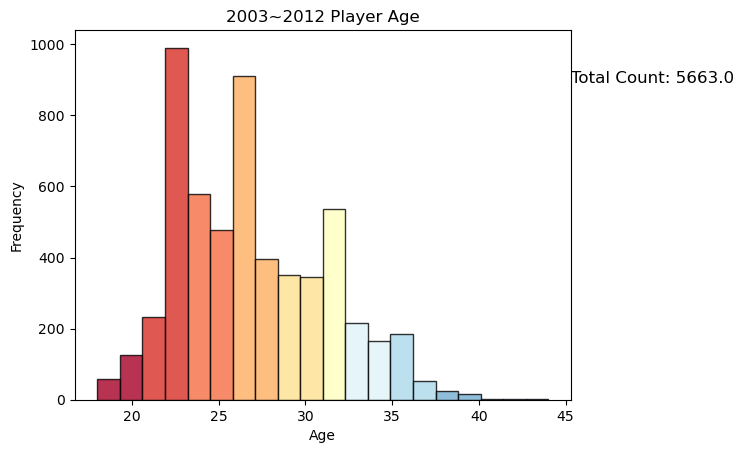

In [6]:
colors = np.array([
    '#a50026', '#d73027', '#f46d43', '#fdae61', '#fee090', '#ffffbf',
    '#e0f3f8', '#abd9e9', '#74add1', '#4575b4', '#313695'
])

n, bins, patches = plt.hist(Data_0312["Age"], bins=20, color=colors[4], alpha=0.8, edgecolor='black')
for i in range(len(patches)):
    color = colors[int(i / (len(patches) / len(colors)))]
    patches[i].set_fc(color)
    
total_count = sum(n)
plt.text(50, max(n)*0.9, f"Total Count: {total_count}", fontsize=12, ha="center")

plt.xlabel("Age")
plt.ylabel("Frequency")
plt.title("2003~2012 Player Age")
plt.show()

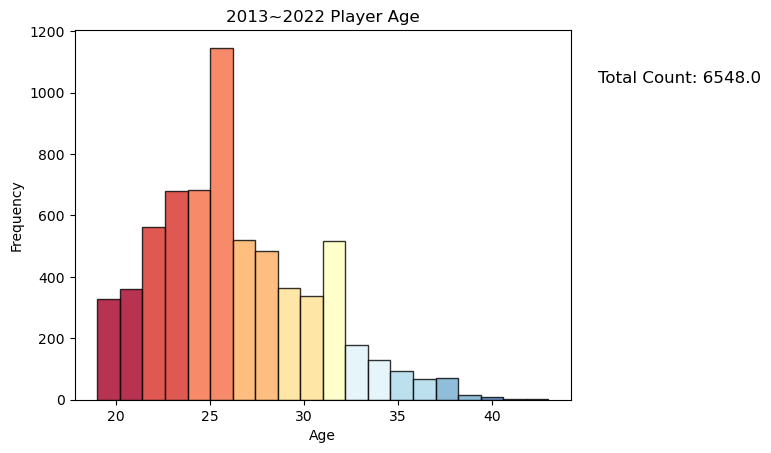

In [7]:
colors = np.array([
    '#a50026', '#d73027', '#f46d43', '#fdae61', '#fee090', '#ffffbf',
    '#e0f3f8', '#abd9e9', '#74add1', '#4575b4', '#313695'
])

n, bins, patches = plt.hist(Data_1322["Age"], bins=20, color=colors[4], alpha=0.8, edgecolor='black')
for i in range(len(patches)):
    color = colors[int(i / (len(patches) / len(colors)))]
    patches[i].set_fc(color)
    
total_count = sum(n)
plt.text(50, max(n)*0.9, f"Total Count: {total_count}", fontsize = 12, ha = "center")

plt.xlabel("Age")
plt.ylabel("Frequency")
plt.title("2013~2022 Player Age")
plt.show()

C:\Users\KenKY_Chi\AppData\Local\Temp\ipykernel_32704\2135070473.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Pos_0312[i] = 'Other'


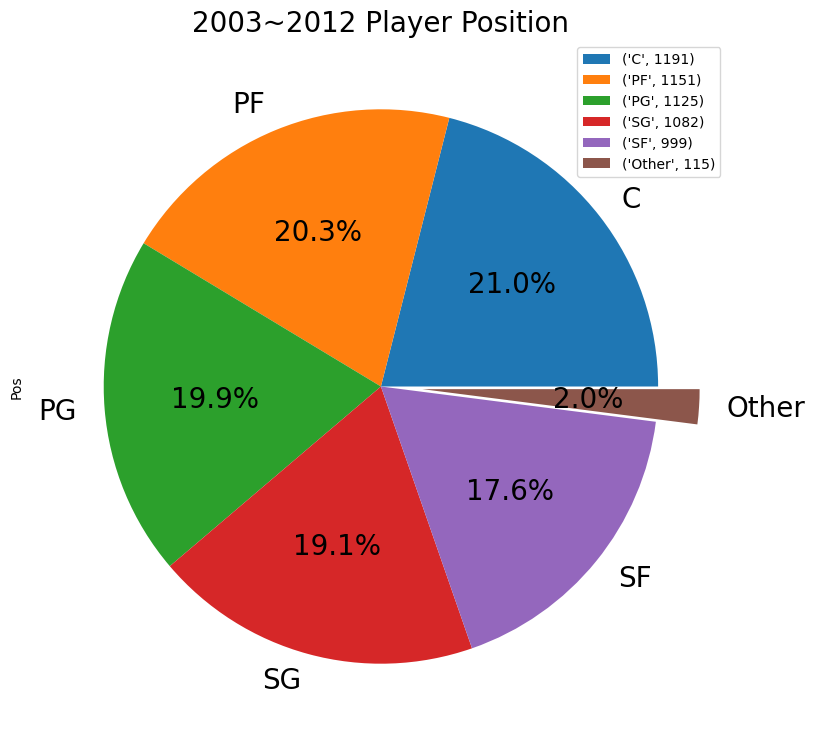

In [8]:
Position_label = ['SG', 'C', 'PG', 'PF', 'SF']

for i in range(len(Pos_0312)):
    if Pos_0312[i] not in Position_label:
        Pos_0312[i] = 'Other'

Position_counts = Pos_0312.value_counts()
Position_counts
explode = [0,0,0,0,0,0.15]
color_labels = {'C': Position_counts[0],
                'PF': Position_counts[1], 
                'PG': Position_counts[2],
                'SG': Position_counts[3],
                'SF': Position_counts[4],
                'Other': Position_counts[5]}
Position_counts.plot(kind = "pie", autopct = "%1.1f%%",
                     figsize=(9,9),fontsize = 20,explode = explode)
plt.legend(color_labels.items(),loc='upper right')
plt.title("2003~2012 Player Position",fontsize=20)
plt.show()

C:\Users\KenKY_Chi\AppData\Local\Temp\ipykernel_32704\4275900679.py:5: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  Pos_1322[i] = 'Other'


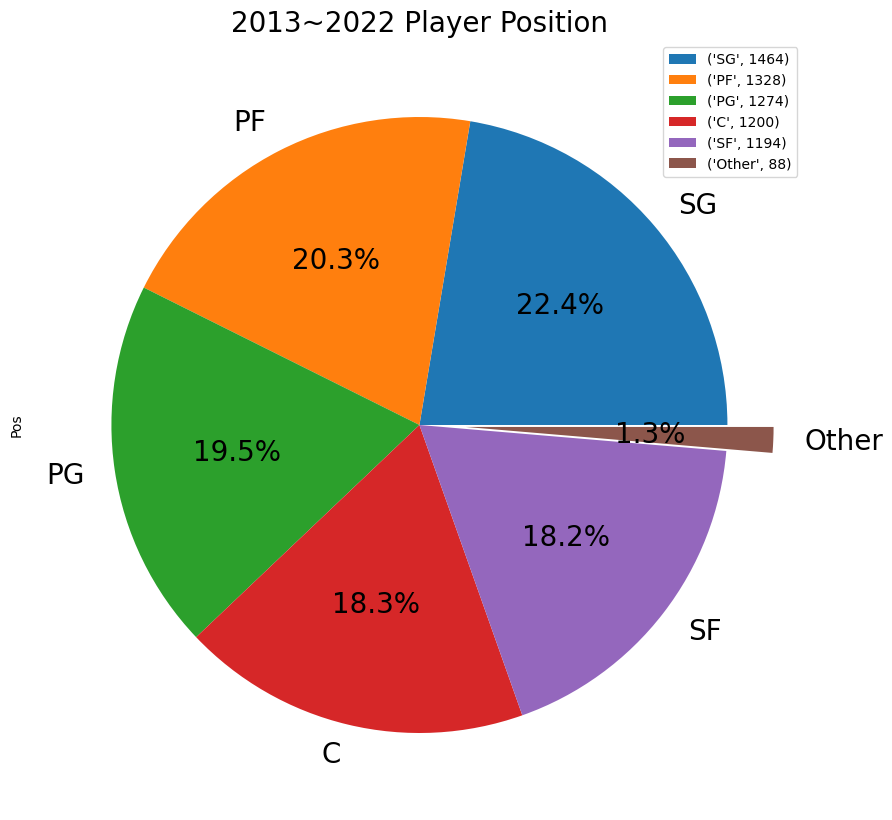

In [9]:
Position_label = ['SG', 'C', 'PG', 'PF', 'SF']

for i in range(len(Pos_1322)):
    if Pos_1322[i] not in Position_label:
        Pos_1322[i] = 'Other'

Position_counts = Pos_1322.value_counts()
Position_counts
explode = [0,0,0,0,0,0.15]
color_labels = {'SG': Position_counts[0],
                'PF': Position_counts[1], 
                'PG': Position_counts[2],
                'C': Position_counts[3],
                'SF': Position_counts[4],
                'Other': Position_counts[5]}
Position_counts.plot(kind = "pie", autopct = "%1.1f%%",
                     figsize=(10,10),fontsize = 20,explode = explode)
plt.legend(color_labels.items(),loc='upper right')
plt.title("2013~2022 Player Position",fontsize=20)
plt.show()

**Player Offensive**

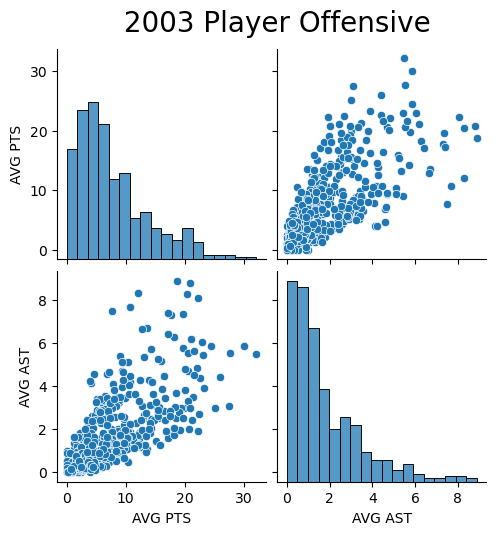

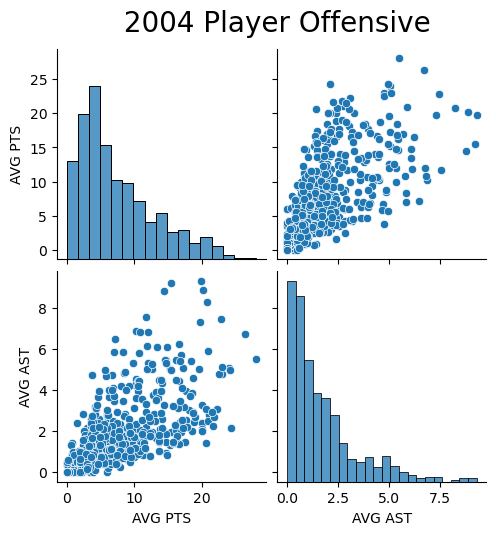

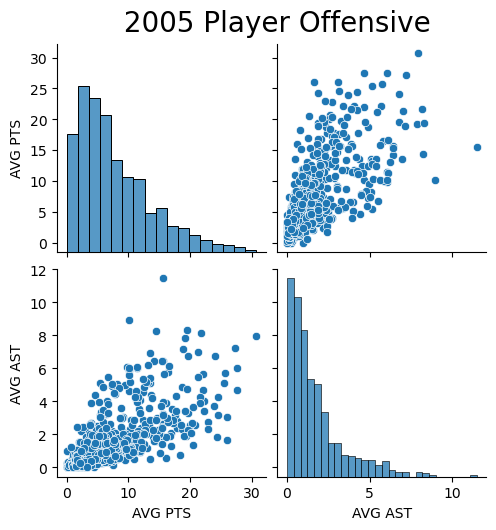

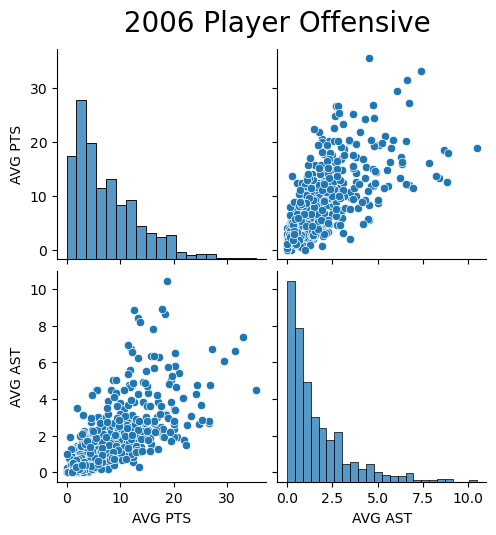

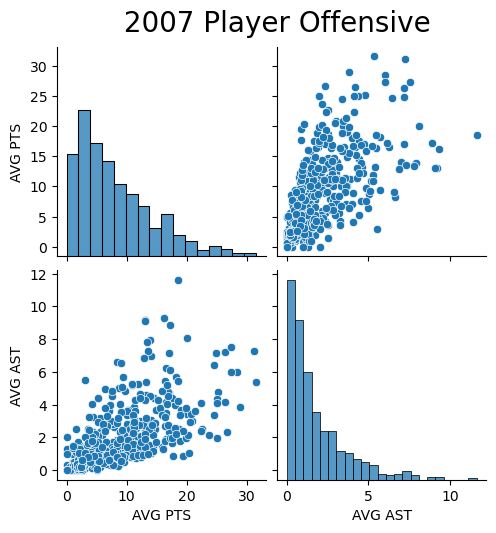

...

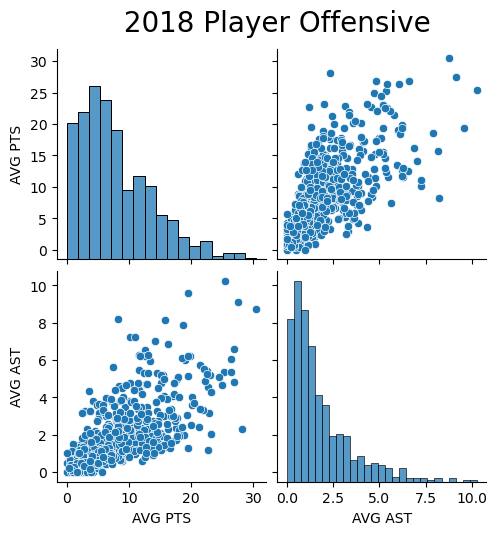

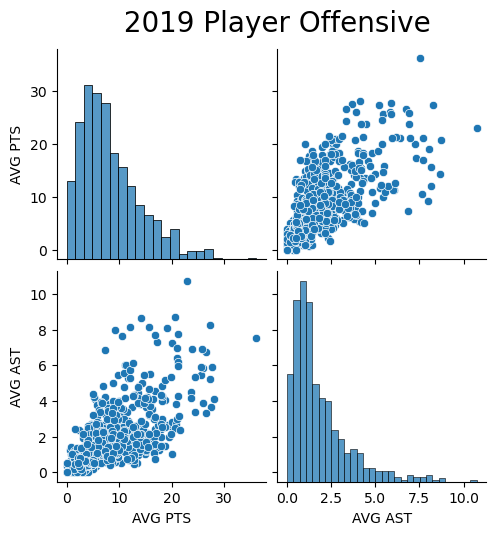

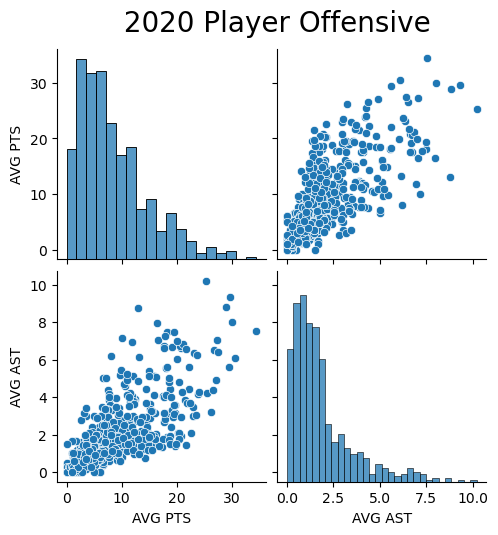

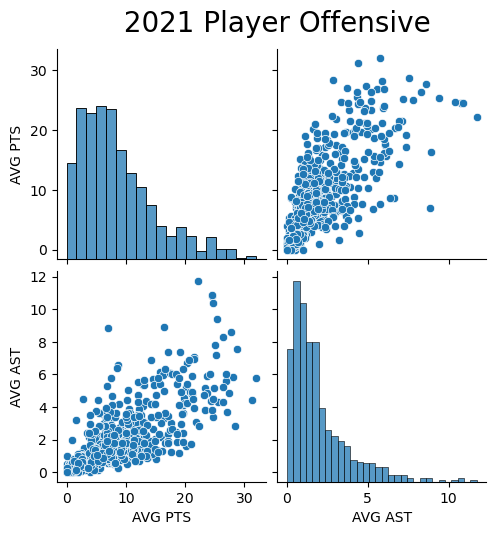

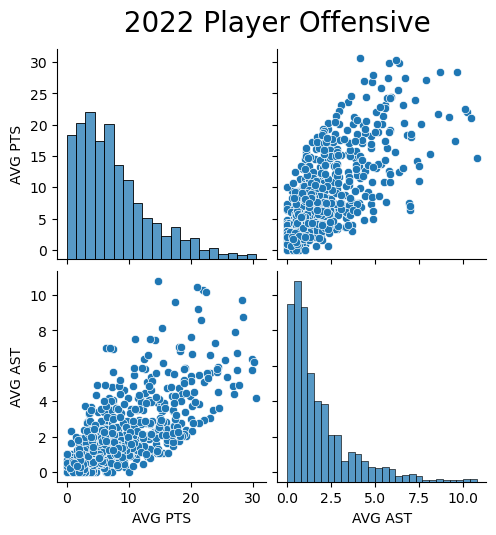

In [10]:
for i in range(1, 21):
    sns.pairplot(dataframes[f"condition_{i}"][["AVG PTS","AVG AST"]])
    plt.title(f" {2002 +i} Player Offensive ", fontsize=20, y=2.1, x=0)

In [11]:
import sklearn.cluster as cluster
import warnings
warnings.filterwarnings("ignore")

kmeans_O = {}
for i in range(1, 21):
    kmeans_O[i] = cluster.KMeans(n_clusters=10, init="k-means++")
    kmeans_O[i] = kmeans_O[i].fit(dataframes[f"condition_{i}"][["AVG PTS", "AVG AST"]])
    kmeans_O[i].cluster_centers_
    dataframes[f"condition_{i}"]["Offensive Clusters"] = kmeans_O[i].labels_
    dataframes[f"condition_{i}"].head()
    print(f"Offensive Clusters for {2002+i}:")
    print(dataframes[f"condition_{i}"]["Offensive Clusters"].value_counts())

Offensive Clusters for 2003:
5    106
0     99
8     68
2     53
1     45
4     40
9     22
6     22
7     21
3      7
Name: Offensive Clusters, dtype: int64
Offensive Clusters for 2004:
8    134
0    106
3     83
7     70
5     50
2     40
1     32
4     25
9     25
6     20
Name: Offensive Clusters, dtype: int64
Offensive Clusters for 2005:
7    135
0    118
3    107
1     78
4     42
5     31
8     24
2     23
6     14
9     13
Name: Offensive Clusters, dtype: int64
Offensive Clusters for 2006:
0    144
3    126
9     80
2     60
6     49
5     36
7     33
1     17
4     14
8      4
Name: Offensive Clusters, dtype: int64
Offensive Clusters for 2007:
8    125
1     99
6     61
0     59
7     57
5     35
3     32
9     19
2     16
4     13
Name: Offensive Clusters, dtype: int64
Offensive Clusters for 2008:
1    121
7    118
5     94
3     82
0     72
2     47
6     30
8     15
4     10
9      6
Name: Offensive Clusters, dtype: int64
Offensive Clusters for 2009:
1    129
4    115
8    

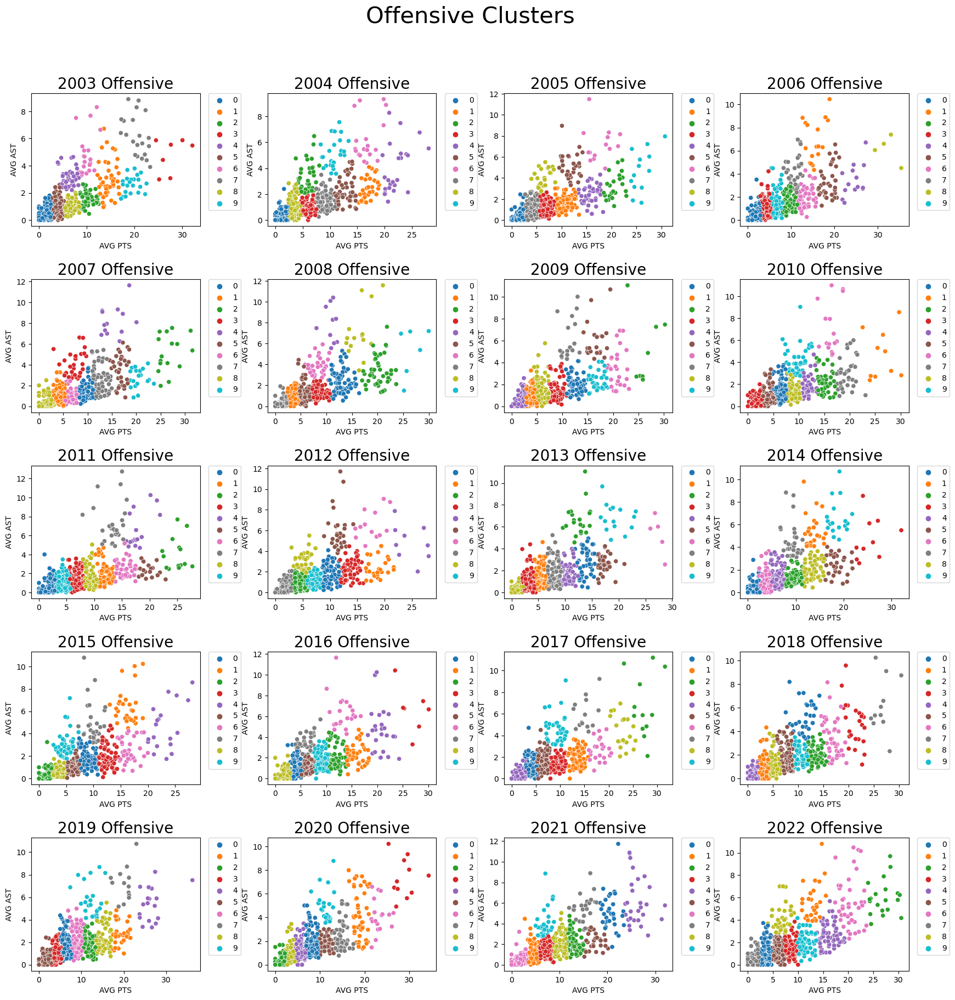

In [12]:
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 20))
fig.suptitle("Offensive Clusters", fontsize=30)
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.4, hspace=0.4)
for i, ax in enumerate(axes.flatten()):
    sns.scatterplot(x="AVG PTS", y="AVG AST", hue="Offensive Clusters", data=dataframes[f"condition_{i+1}"], palette="tab10", ax=ax)
    ax.set_title(f"{2003+i} Offensive", fontsize=20)
    ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., prop={'size': 10})
    ax.set_xlabel("AVG PTS")
    ax.set_ylabel("AVG AST")

<Figure size 2000x2000 with 0 Axes>

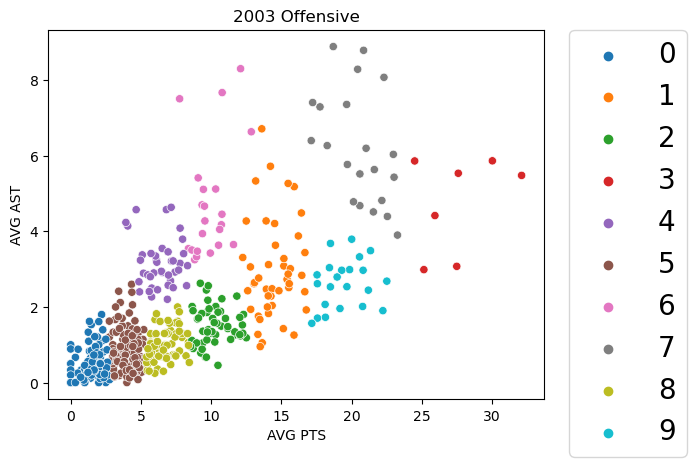

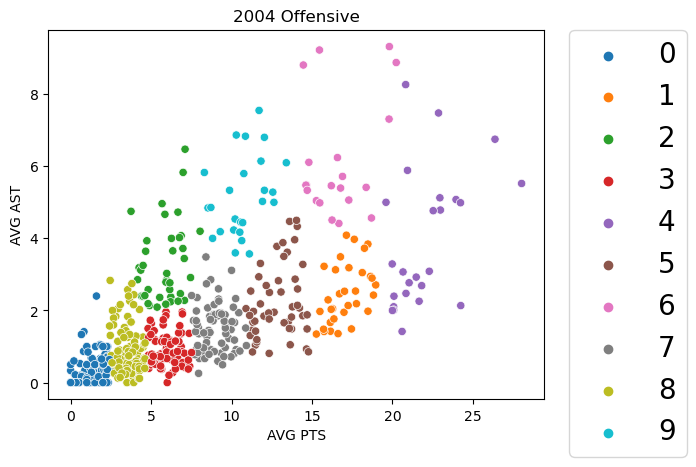

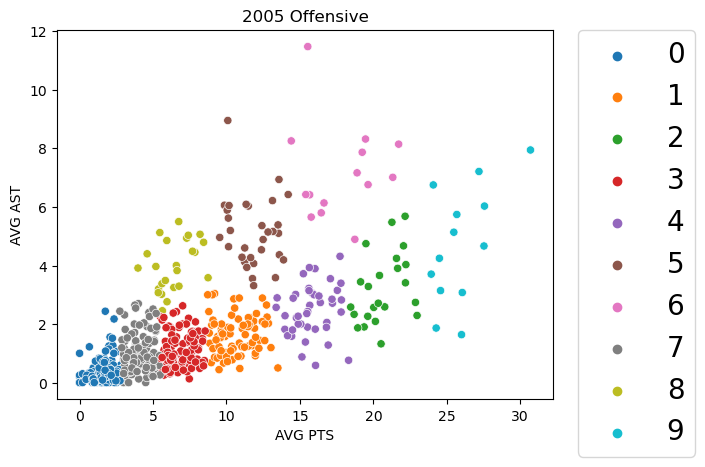

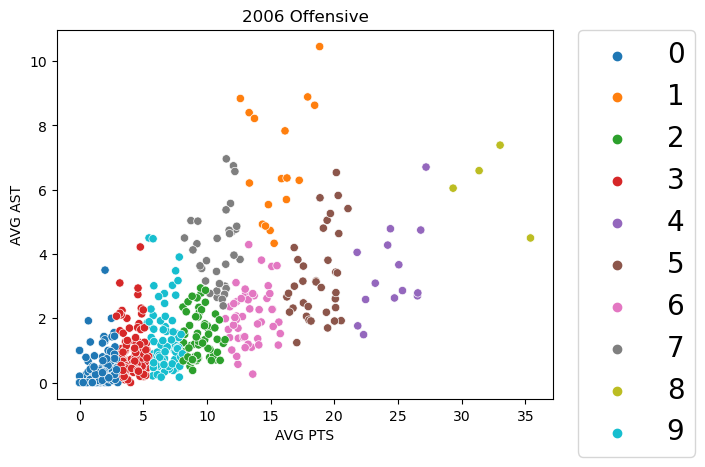

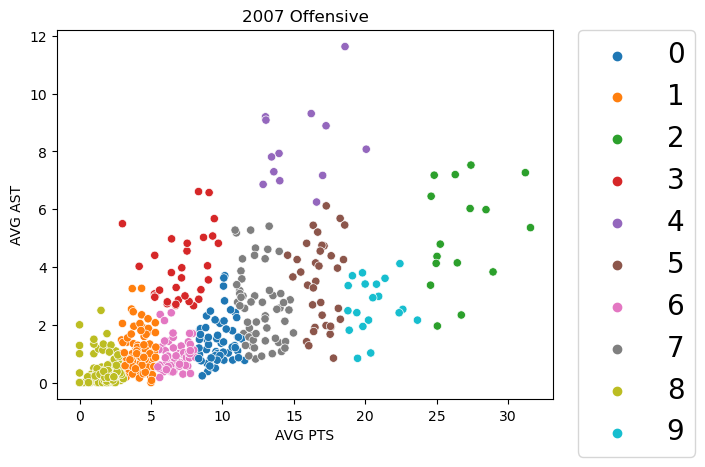

...

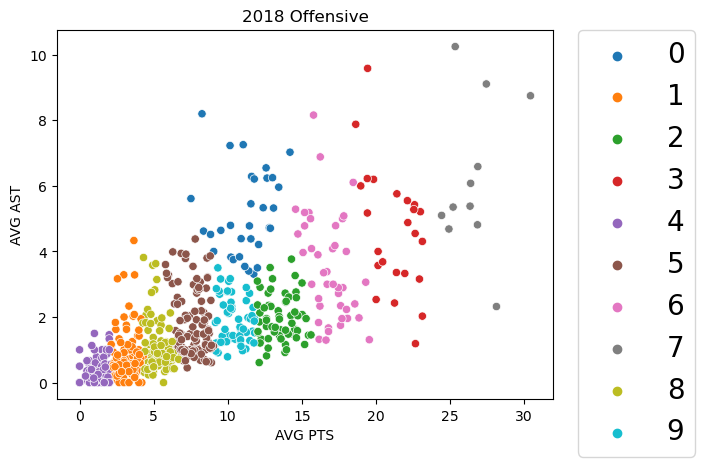

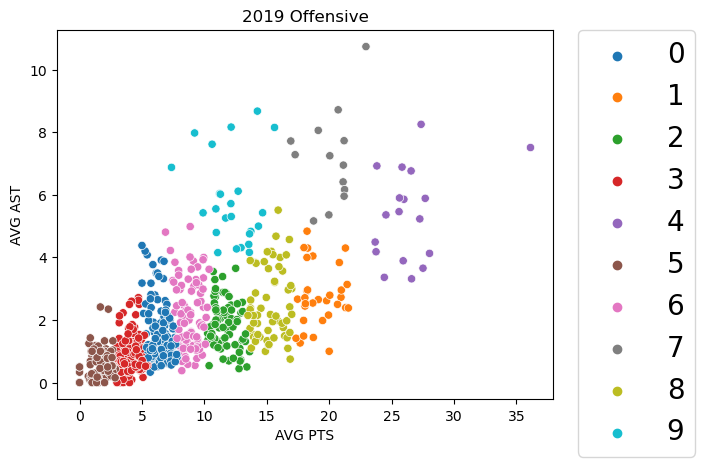

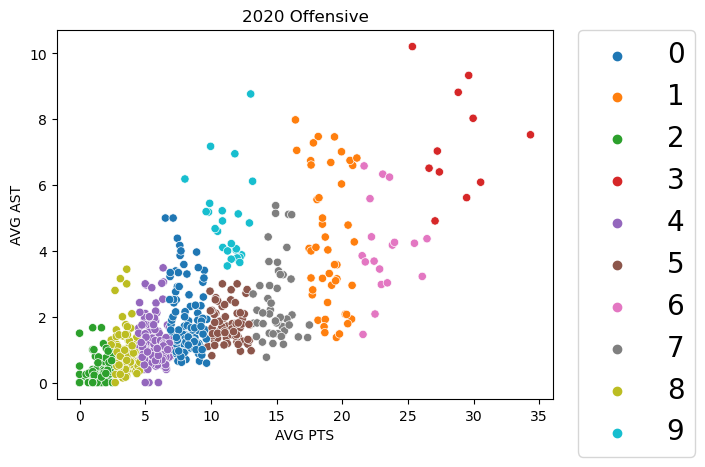

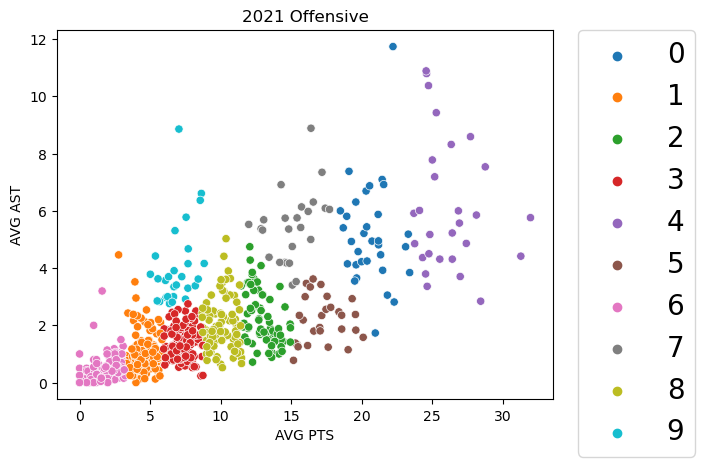

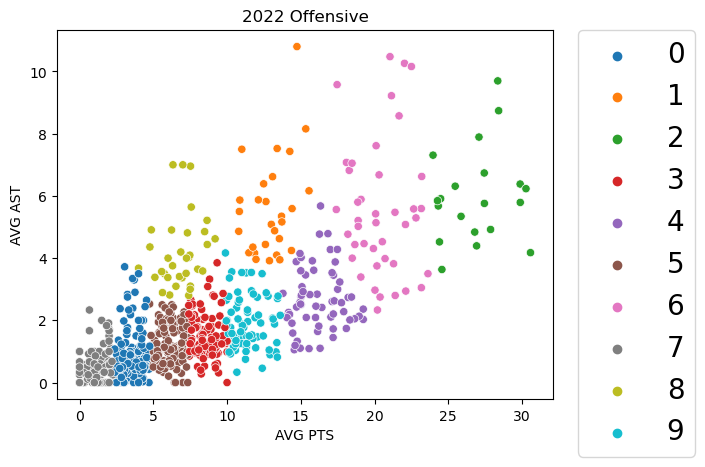

In [13]:
fig = plt.figure(figsize=(20, 20))
for i in range(1, 21):
    plt.figure()
    plt.rcParams['font.size'] = 10
    sns.scatterplot(x="AVG PTS",y="AVG AST",hue = "Offensive Clusters", data = dataframes[f"condition_{i}"], palette="tab10")
    plt.title(f"{2002 + i} Offensive")
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.,prop={'size': 20})

In [14]:
conditions_O = {}
for i in range(1, 21):
    groups = dataframes[f"condition_{i}"].groupby('Offensive Clusters')
    conditions_O[i] = groups.agg({'AVG PTS': 'mean', 'AVG AST': 'mean'})
    print(f"{2002+i} - Offensive Clusters:")
    print(conditions_O[i].round(2))
    print()

2003 - Offensive Clusters:
                    AVG PTS  AVG AST
Offensive Clusters                  
0                      1.50     0.48
1                     14.47     2.95
2                     10.24     1.49
3                     27.53     4.75
4                      6.38     3.16
5                      4.01     0.83
6                      9.91     4.72
7                     20.54     6.21
8                      6.64     0.99
9                     19.44     2.62

2004 - Offensive Clusters:
                    AVG PTS  AVG AST
Offensive Clusters                  
0                      1.36     0.39
1                     17.07     2.46
2                      5.81     3.25
3                      6.01     0.92
4                     22.01     3.93
5                     12.85     2.21
6                     16.65     6.14
7                      8.99     1.51
8                      3.59     0.78
9                     10.71     5.15

2005 - Offensive Clusters:
                    AVG PTS  

**Player Rebound**

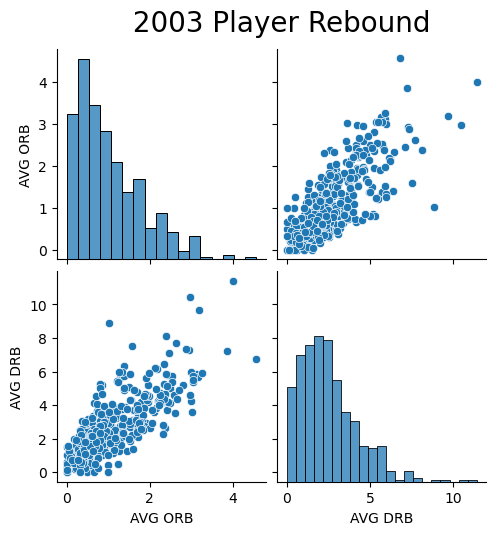

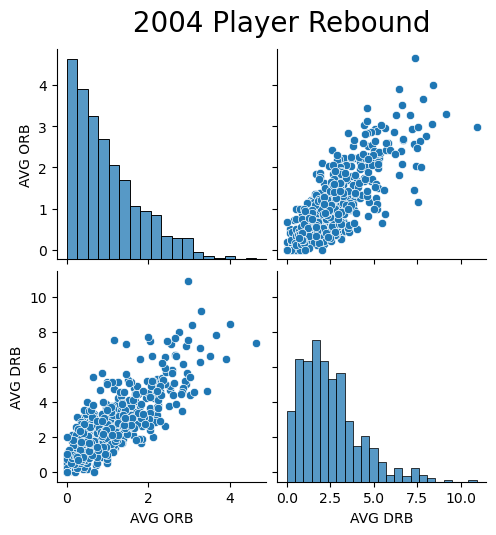

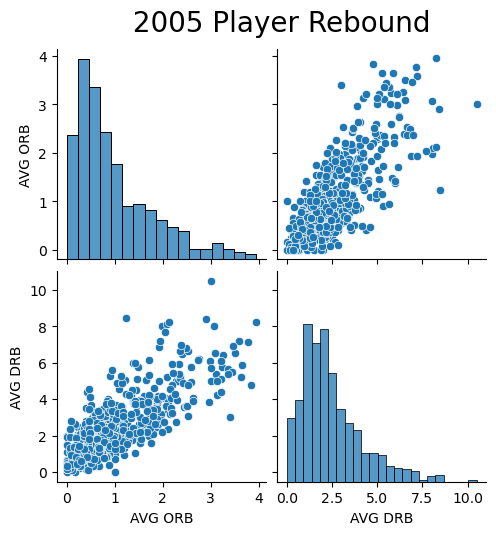

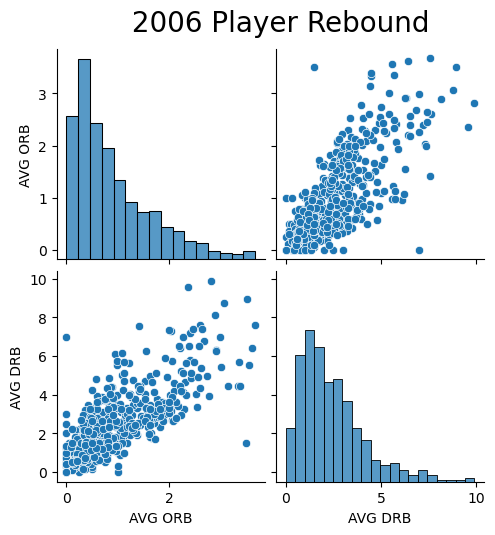

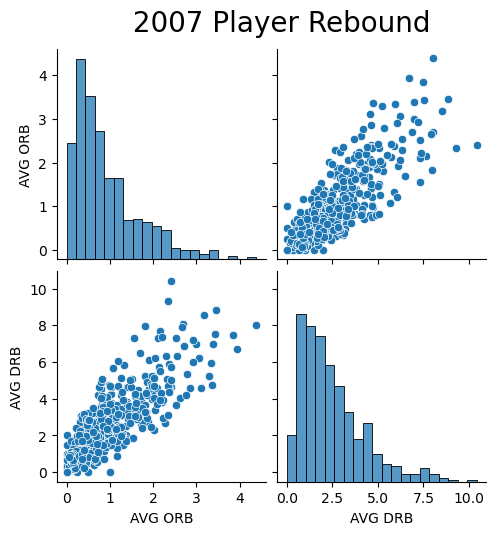

...

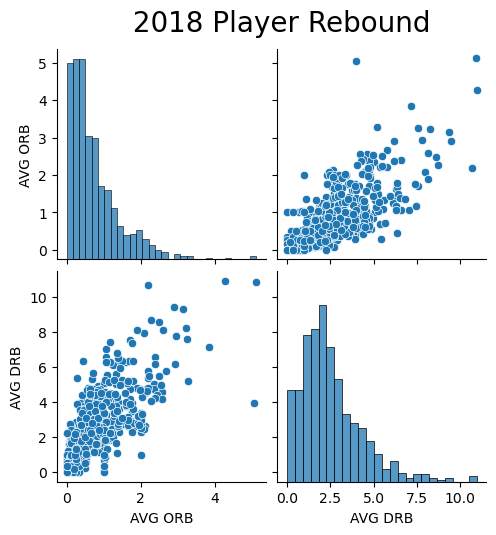

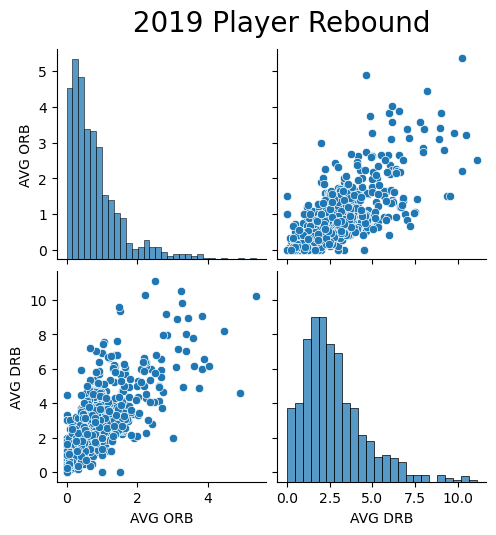

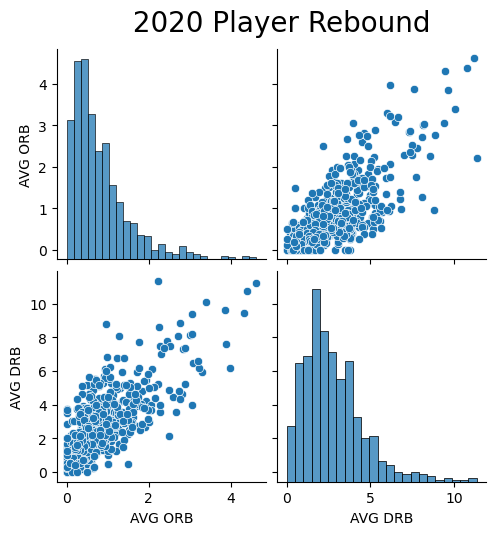

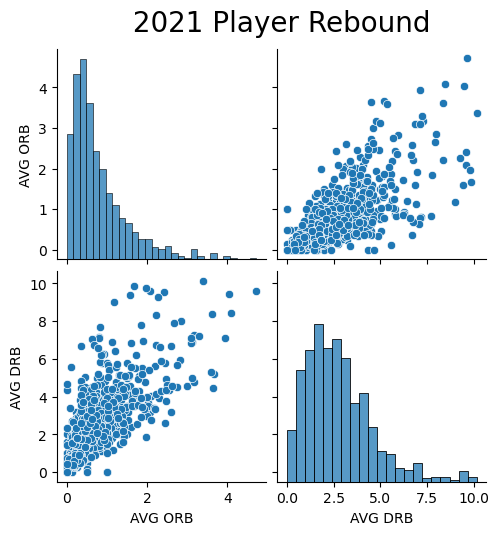

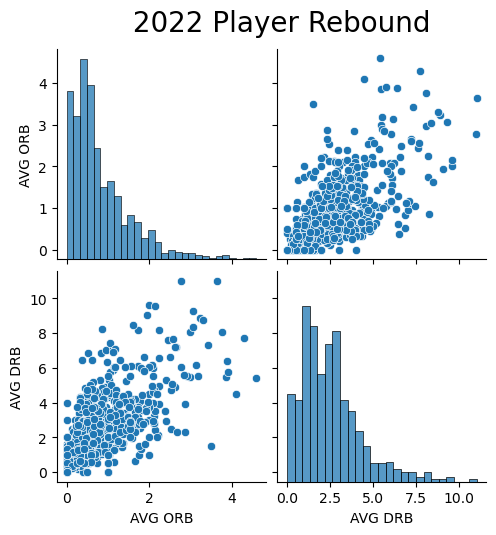

In [15]:
for i in range(1, 21):  
    sns.pairplot(dataframes[f"condition_{i}"][["AVG ORB","AVG DRB"]])
    plt.title(f" {2002 +i} Player Rebound", fontsize=20, y=2.1, x=0)

In [16]:
kmeans_R = {}
for i in range(1, 21):
    kmeans_R[i] = cluster.KMeans(n_clusters=10, init="k-means++")
    kmeans_R[i] = kmeans_R[i].fit(dataframes[f"condition_{i}"][["AVG DRB", "AVG TRB"]])
    kmeans_R[i].cluster_centers_
    dataframes[f"condition_{i}"]["Rebound Clusters"] = kmeans_R[i].labels_
    dataframes[f"condition_{i}"].head()
    print(f"Rebound Clusters for {2002+i}:")
    print(dataframes[f"condition_{i}"]["Rebound Clusters"].value_counts())

Rebound Clusters for 2003:
3    84
6    74
0    73
7    73
9    65
5    41
2    36
1    25
4     9
8     3
Name: Rebound Clusters, dtype: int64
Rebound Clusters for 2004:
5    113
7    105
3     91
6     76
0     63
1     47
9     38
4     27
2     19
8      6
Name: Rebound Clusters, dtype: int64
Rebound Clusters for 2005:
1    122
4    112
8     94
7     61
0     59
9     41
3     32
6     27
2     25
5     12
Name: Rebound Clusters, dtype: int64
Rebound Clusters for 2006:
1    106
8     93
0     82
5     70
9     70
4     50
7     38
3     29
6     19
2      6
Name: Rebound Clusters, dtype: int64
Rebound Clusters for 2007:
8    107
0     91
2     89
4     65
5     63
7     42
1     24
9     15
6     15
3      5
Name: Rebound Clusters, dtype: int64
Rebound Clusters for 2008:
7    120
2    119
9    118
0     69
4     63
1     34
3     29
6     25
8     15
5      3
Name: Rebound Clusters, dtype: int64
Rebound Clusters for 2009:
6    118
8    102
2    100
0     83
5     61
1     40
3    

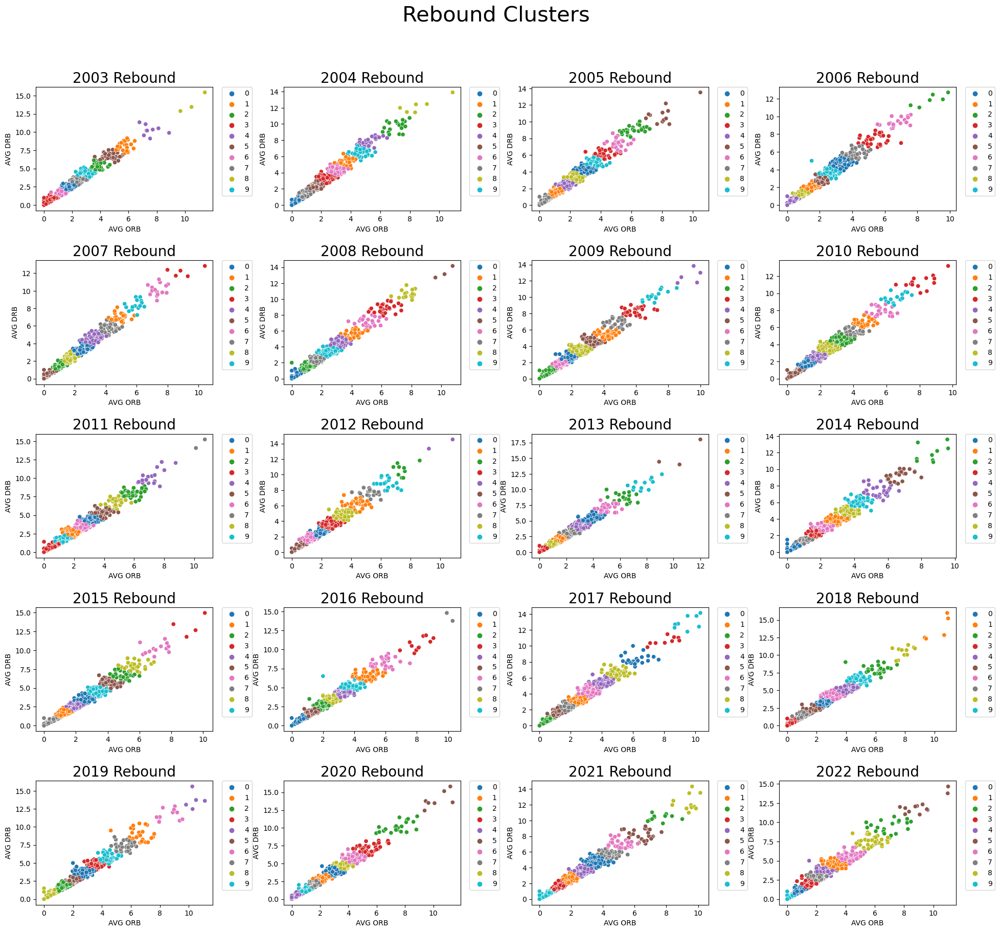

In [17]:
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 20))
fig.suptitle("Rebound Clusters", fontsize=30)
plt.subplots_adjust(left=0.05, right=0.95, top=0.9, bottom=0.1, wspace=0.4, hspace=0.4)
for i, ax in enumerate(axes.flatten()):
    sns.scatterplot(x="AVG DRB", y="AVG TRB", hue="Rebound Clusters", data=dataframes[f"condition_{i+1}"], palette="tab10", ax=ax)
    ax.set_title(f"{2003+i} Rebound", fontsize=20)
    ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., prop={'size': 10})
    ax.set_xlabel("AVG ORB")
    ax.set_ylabel("AVG DRB")

<Figure size 2000x2000 with 0 Axes>

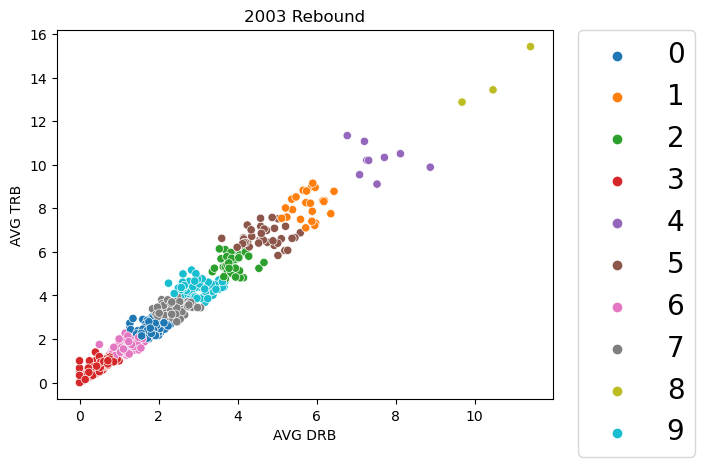

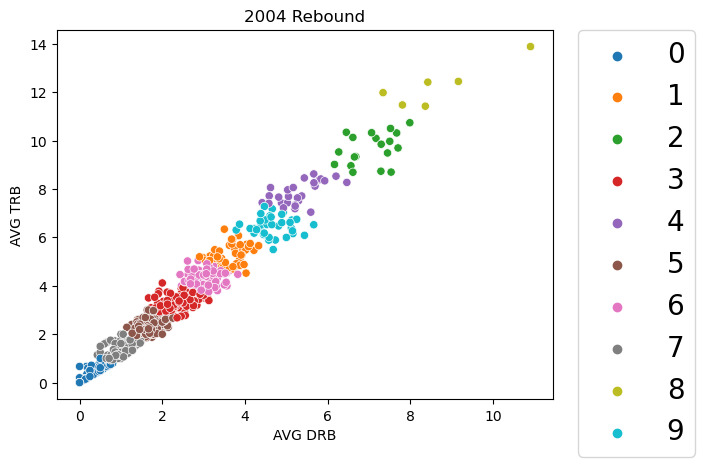

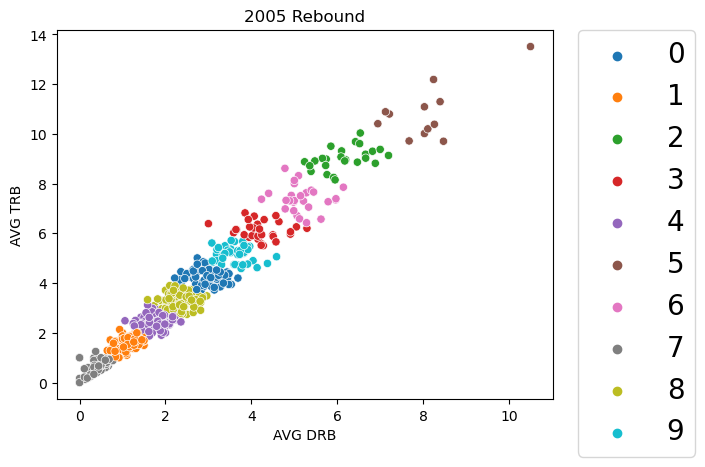

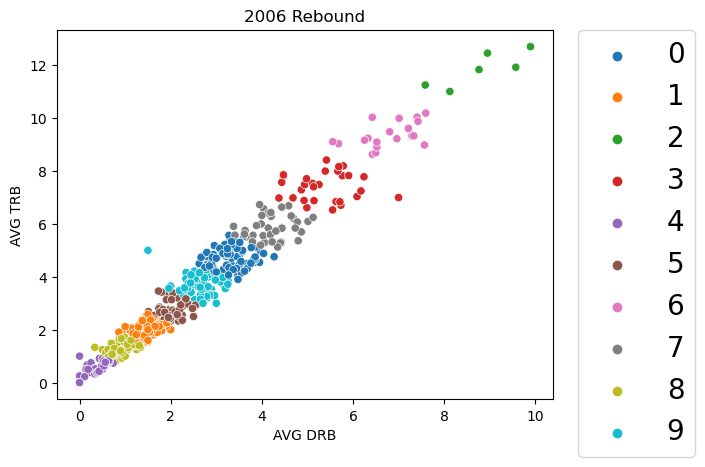

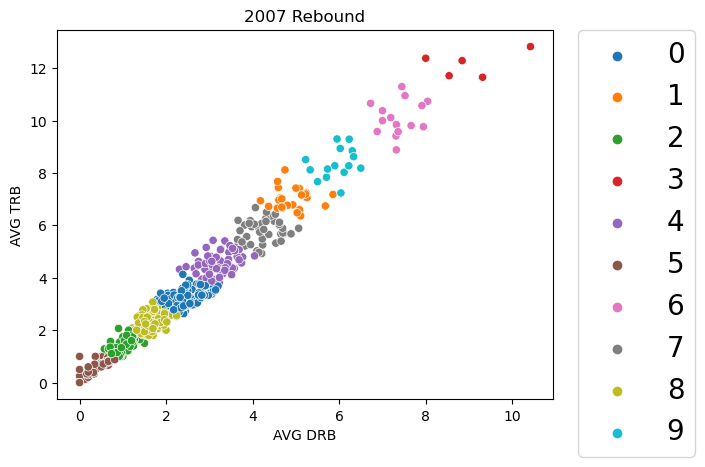

...

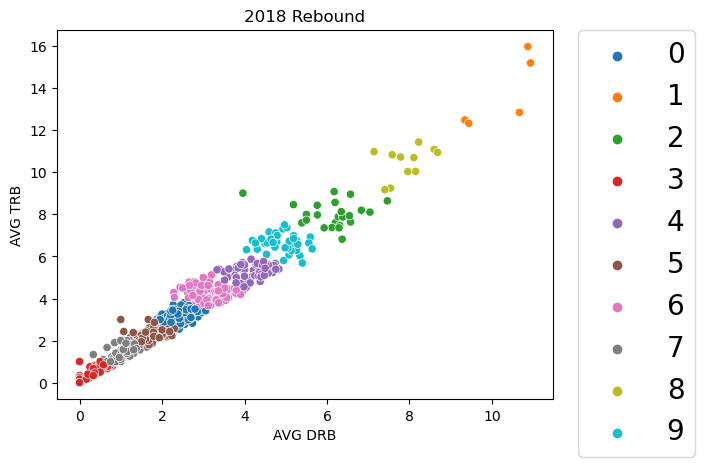

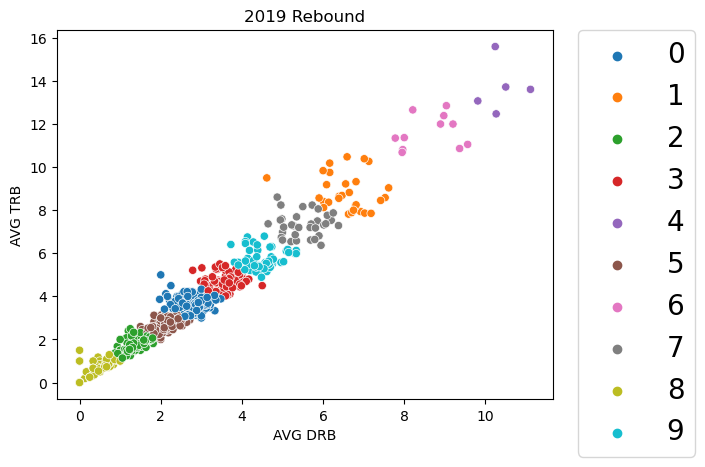

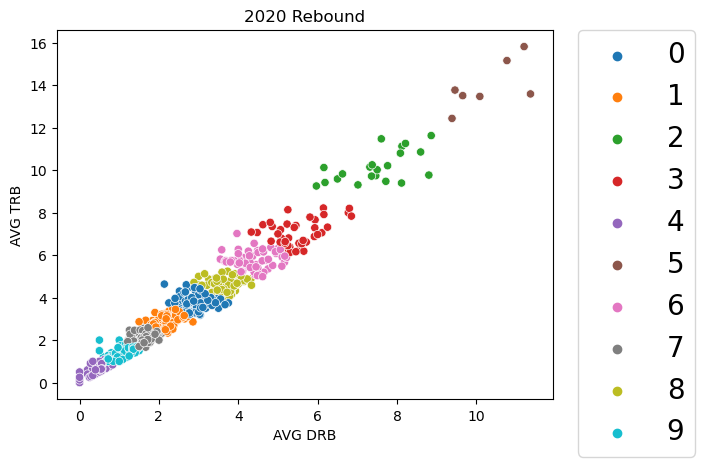

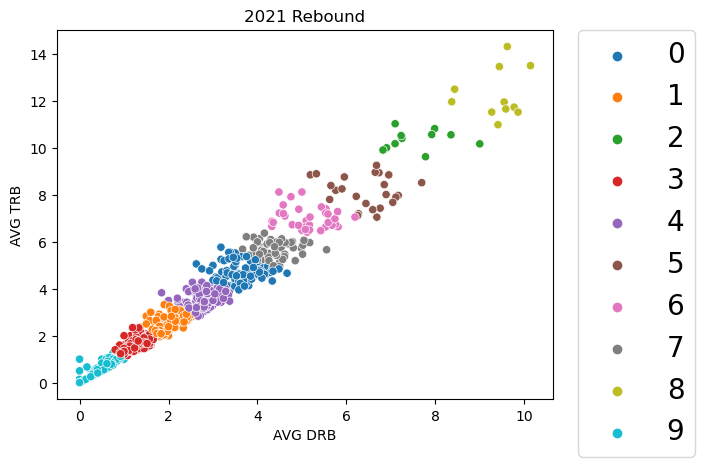

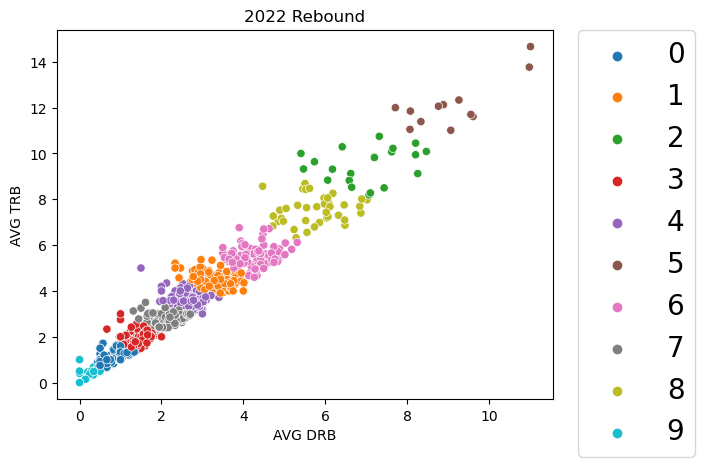

In [18]:
fig = plt.figure(figsize=(20, 20))
for i in range(1, 21):
    plt.figure()
    plt.rcParams['font.size'] = 10
    sns.scatterplot(x="AVG DRB",y="AVG TRB",hue = "Rebound Clusters", data = dataframes[f"condition_{i}"], palette="tab10")
    plt.title(f"{2002 + i} Rebound")
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.,prop={'size': 20})

In [19]:
conditions_R = {}
for i in range(1, 21):
    groups = dataframes[f"condition_{i}"].groupby('Rebound Clusters')
    conditions_R[i] = groups.agg({'AVG DRB': 'mean', 'AVG TRB': 'mean'})
    print(f"{2002+i} - Rebound Clusters:")
    print(conditions_R[i].round(2))
    print()

2003 - Rebound Clusters:
                  AVG DRB  AVG TRB
Rebound Clusters                  
0                    1.81     2.49
1                    5.79     8.14
2                    3.88     5.41
3                    0.49     0.74
4                    7.54    10.25
5                    4.64     6.67
6                    1.22     1.70
7                    2.42     3.34
8                   10.52    13.91
9                    3.01     4.38

2004 - Rebound Clusters:
                  AVG DRB  AVG TRB
Rebound Clusters                  
0                    0.36     0.47
1                    3.63     5.29
2                    7.06     9.67
3                    2.39     3.31
4                    5.29     7.82
5                    1.71     2.32
6                    3.03     4.30
7                    0.99     1.36
8                    8.66    12.28
9                    4.66     6.47

2005 - Rebound Clusters:
                  AVG DRB  AVG TRB
Rebound Clusters                  
0            

**Player Defensive**

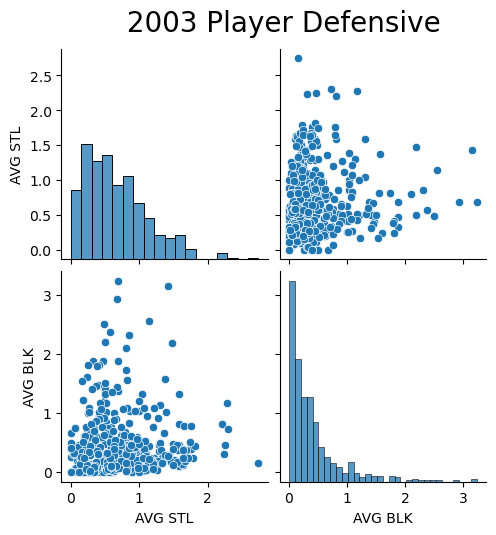

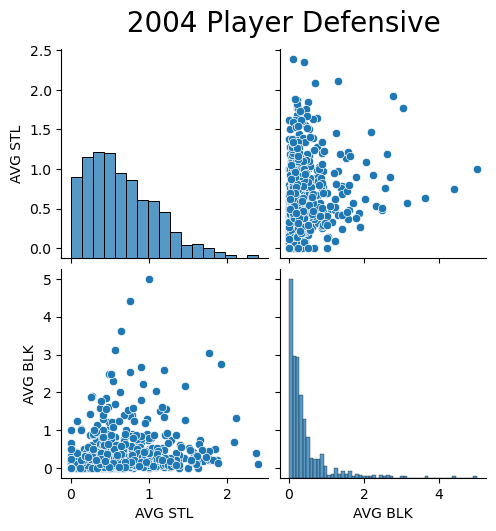

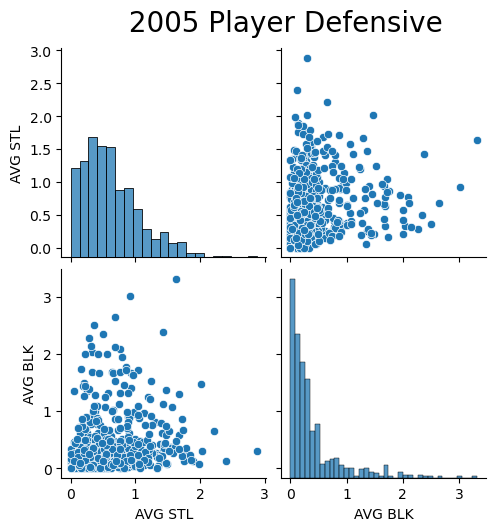

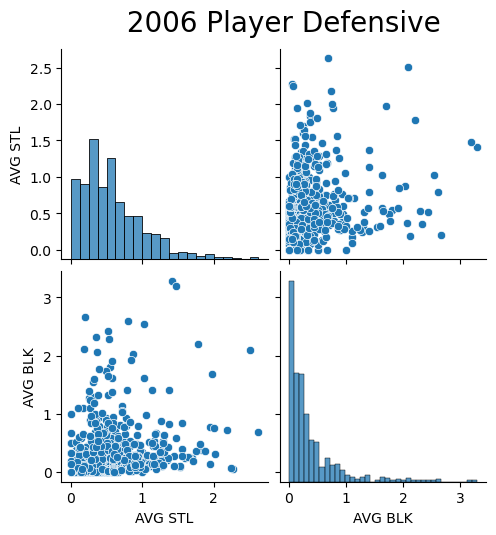

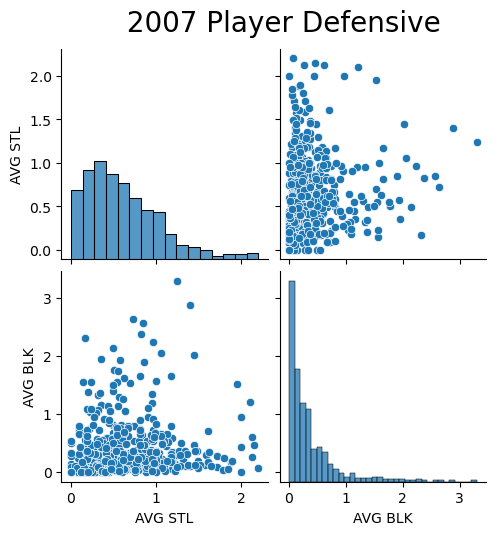

...

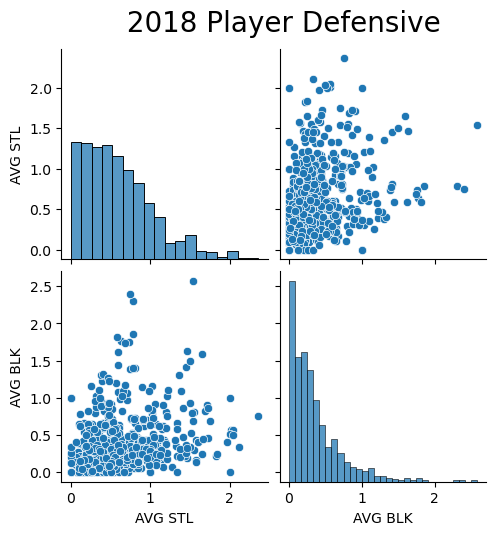

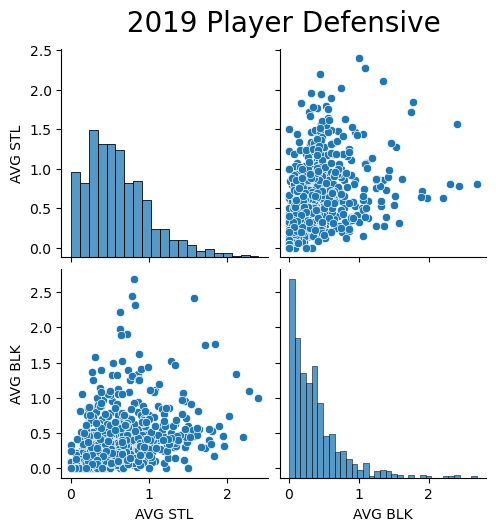

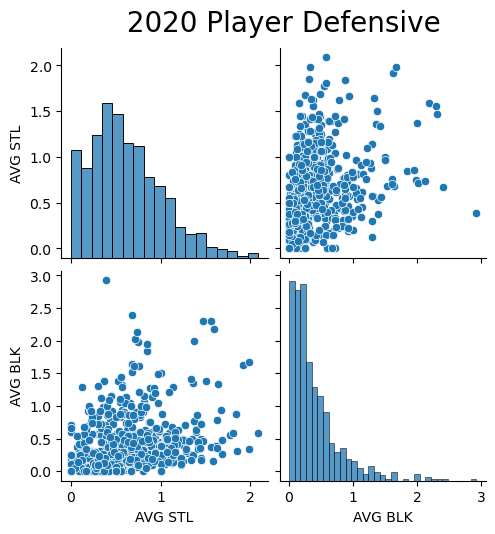

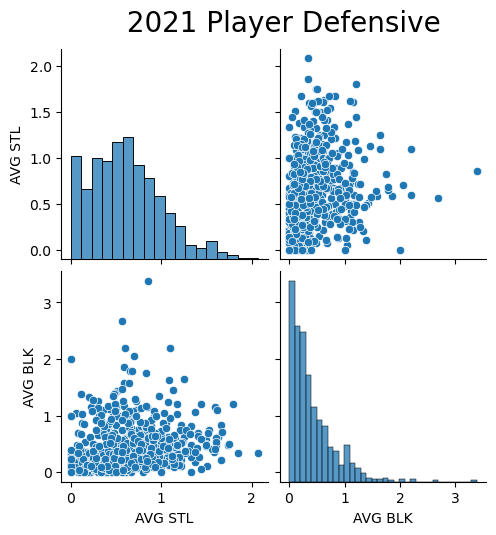

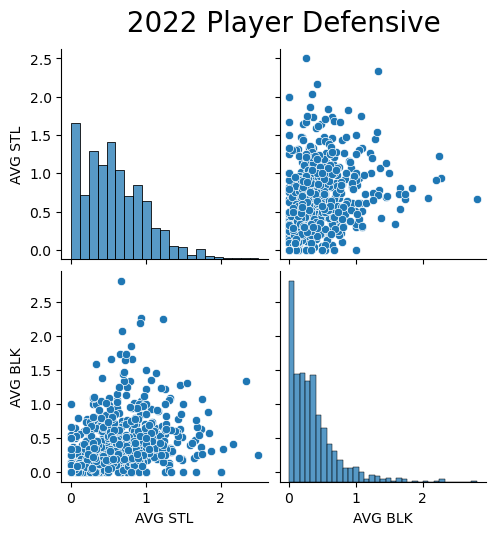

In [20]:
for i in range(1, 21):   
    sns.pairplot(dataframes[f"condition_{i}"][["AVG STL","AVG BLK"]])
    plt.title(f" {2002 +i} Player Defensive", fontsize=20, y=2.1, x=0)

In [21]:
kmeans_D = {}
for i in range(1, 21):
    kmeans_D[i] = cluster.KMeans(n_clusters=10, init="k-means++")
    kmeans_D[i] = kmeans_R[i].fit(dataframes[f"condition_{i}"][["AVG STL", "AVG BLK"]])
    kmeans_D[i].cluster_centers_
    dataframes[f"condition_{i}"]["Defensive Clusters"] = kmeans_D[i].labels_
    dataframes[f"condition_{i}"].head()
    print(f"Defensive Clusters for {2002+i}:")
    print(dataframes[f"condition_{i}"]["Defensive Clusters"].value_counts())

Defensive Clusters for 2003:
3    118
6     94
0     76
9     53
2     43
4     43
1     23
5     16
7     10
8      7
Name: Defensive Clusters, dtype: int64
Defensive Clusters for 2004:
8    133
9    106
2     97
0     90
5     50
4     36
6     30
1     28
7     12
3      3
Name: Defensive Clusters, dtype: int64
Defensive Clusters for 2005:
9    141
1    116
4     95
3     68
6     54
0     30
7     28
5     26
2     23
8      4
Name: Defensive Clusters, dtype: int64
Defensive Clusters for 2006:
5    142
3    118
1     75
0     70
6     56
9     50
2     20
4     18
8      9
7      5
Name: Defensive Clusters, dtype: int64
Defensive Clusters for 2007:
6    95
3    83
9    83
0    70
1    65
4    47
8    27
2    24
7    17
5     5
Name: Defensive Clusters, dtype: int64
Defensive Clusters for 2008:
4    140
0    120
8     84
9     83
3     51
5     35
1     31
7     25
2     14
6     12
Name: Defensive Clusters, dtype: int64
Defensive Clusters for 2009:
8    108
0    107
9     93
4     

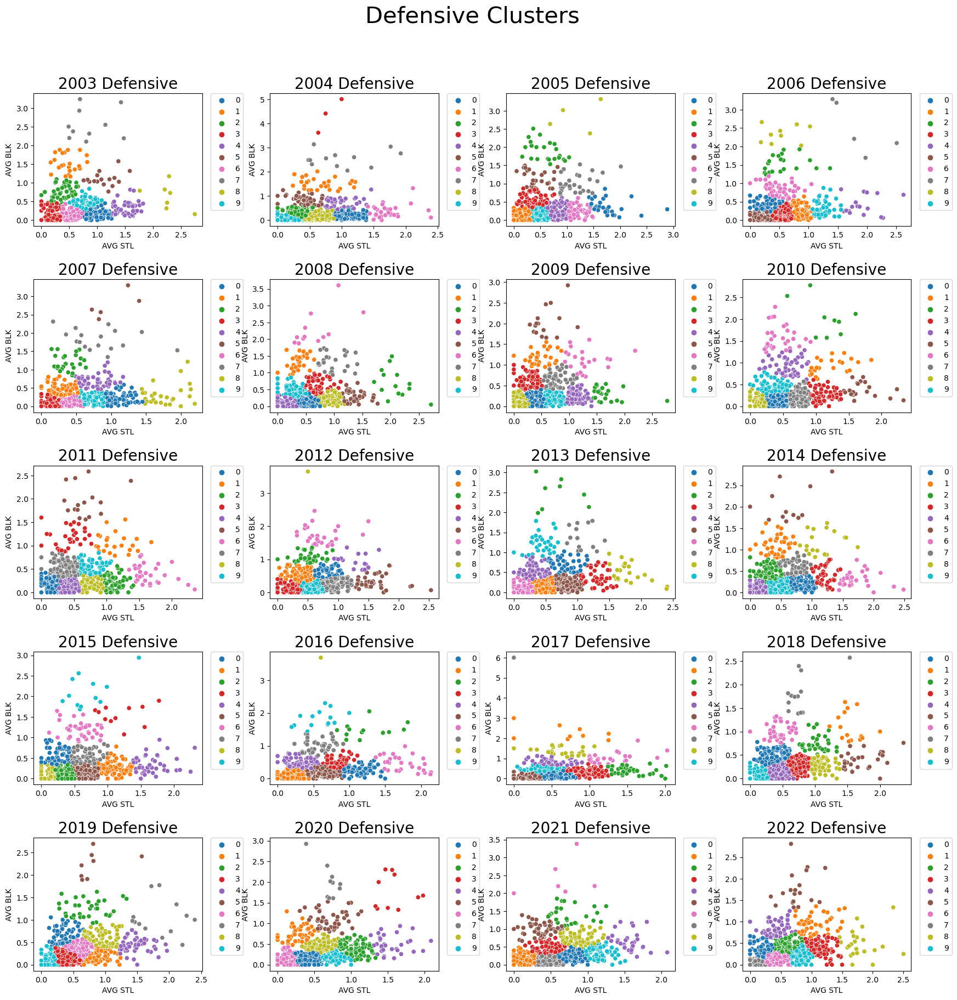

In [22]:
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 20))
fig.suptitle("Defensive Clusters", fontsize=30)
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.4, hspace=0.4)
for i, ax in enumerate(axes.flatten()):
    sns.scatterplot(x="AVG STL", y="AVG BLK", hue="Defensive Clusters", data=dataframes[f"condition_{i+1}"], palette="tab10", ax=ax)
    ax.set_title(f"{2003+i} Defensive", fontsize=20)
    ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., prop={'size': 10})
    ax.set_xlabel("AVG STL")
    ax.set_ylabel("AVG BLK")

<Figure size 2000x2000 with 0 Axes>

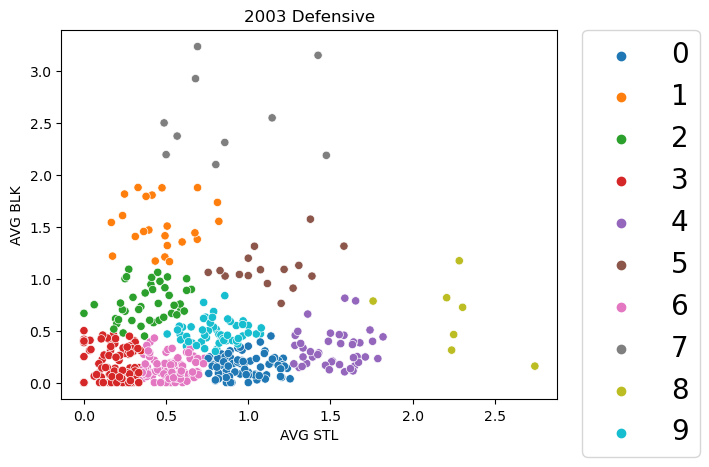

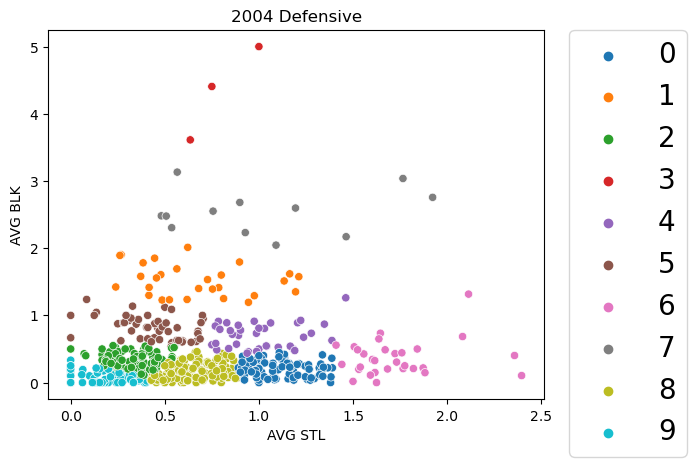

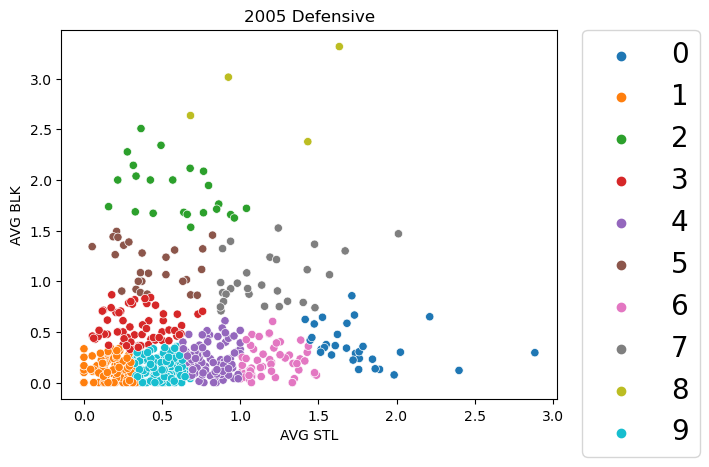

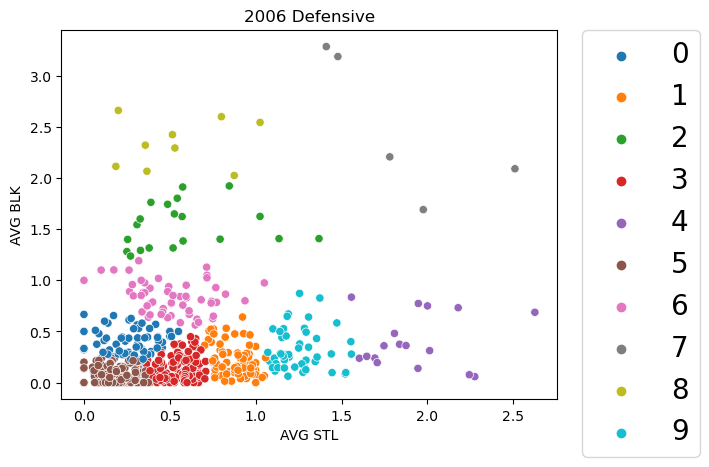

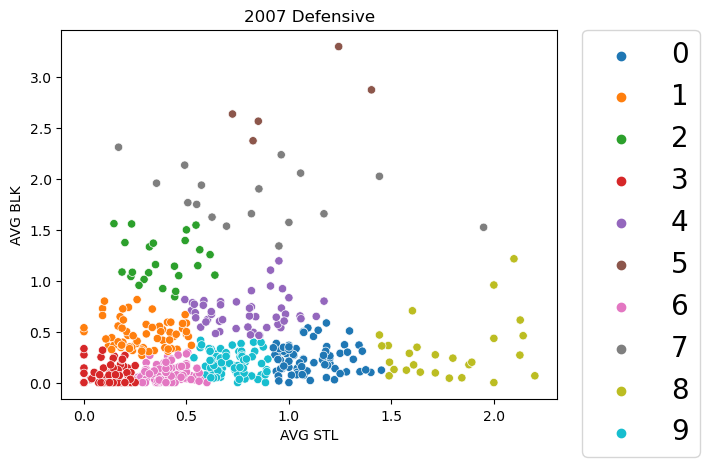

...

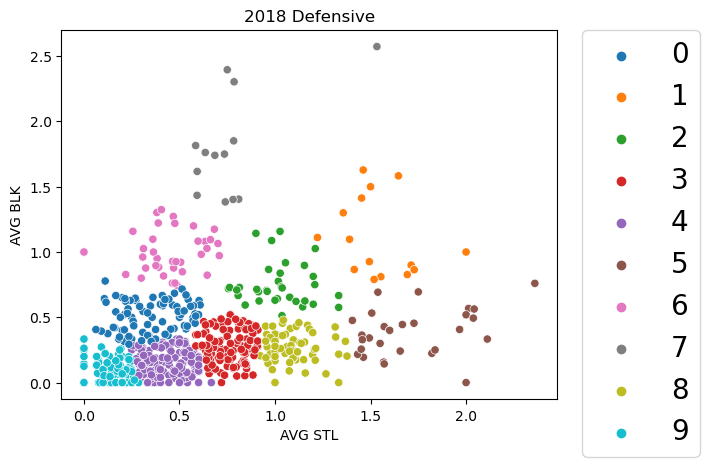

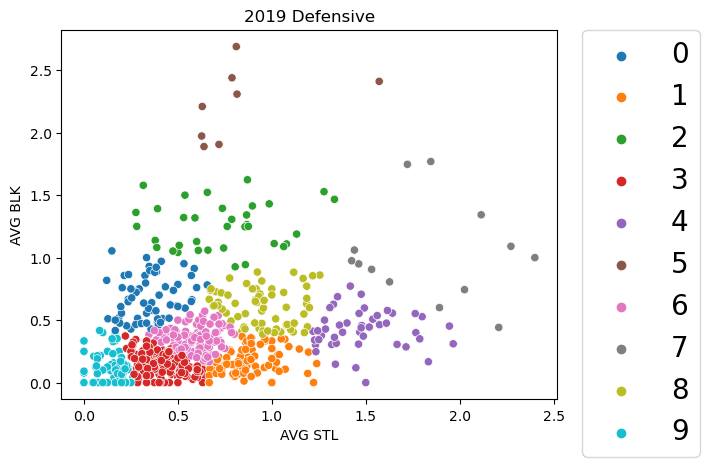

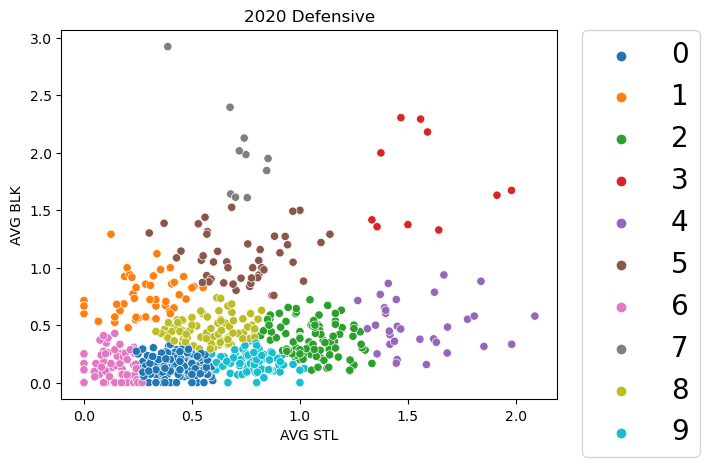

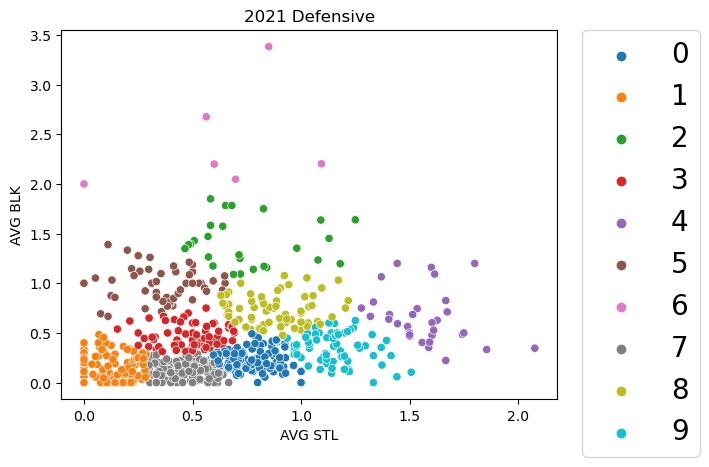

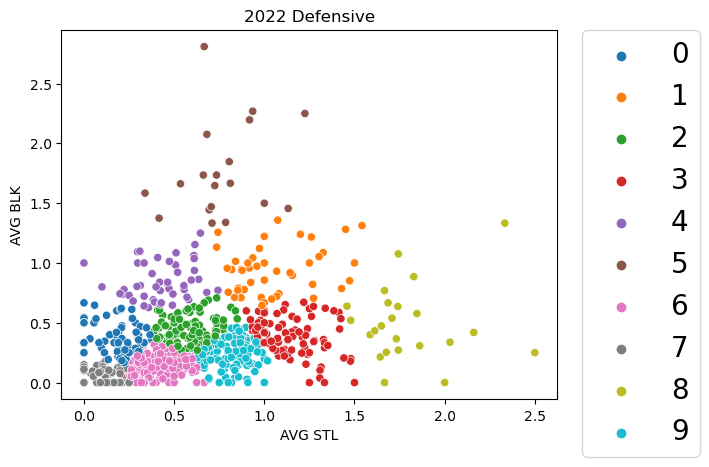

In [23]:
fig = plt.figure(figsize=(20, 20))
for i in range(1, 21):
    plt.figure()
    plt.rcParams['font.size'] = 10
    sns.scatterplot(x="AVG STL",y="AVG BLK",hue = "Defensive Clusters", data = dataframes[f"condition_{i}"], palette="tab10")
    plt.title(f"{2002 + i} Defensive")
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.,prop={'size': 20})

In [24]:
conditions_D = {}
for i in range(1, 21):
    groups = dataframes[f"condition_{i}"].groupby('Defensive Clusters')
    conditions_D[i] = groups.agg({'AVG STL': 'mean', 'AVG BLK': 'mean'})
    print(f"{2002+i} - Defensive Clusters:")
    print(conditions_D[i].round(2))
    print()

2003 - Defensive Clusters:
                    AVG STL  AVG BLK
Defensive Clusters                  
0                      0.97     0.16
1                      0.47     1.52
2                      0.38     0.76
3                      0.17     0.15
4                      1.51     0.32
5                      1.12     1.10
6                      0.52     0.14
7                      0.86     2.55
8                      2.26     0.63
9                      0.80     0.48

2004 - Defensive Clusters:
                    AVG STL  AVG BLK
Defensive Clusters                  
0                      1.11     0.20
1                      0.67     1.52
2                      0.32     0.32
3                      0.80     4.34
4                      1.01     0.70
5                      0.44     0.82
6                      1.73     0.36
7                      1.01     2.54
8                      0.66     0.15
9                      0.14     0.06

2005 - Defensive Clusters:
                    AVG STL  

**Turnover_Personal Foul**

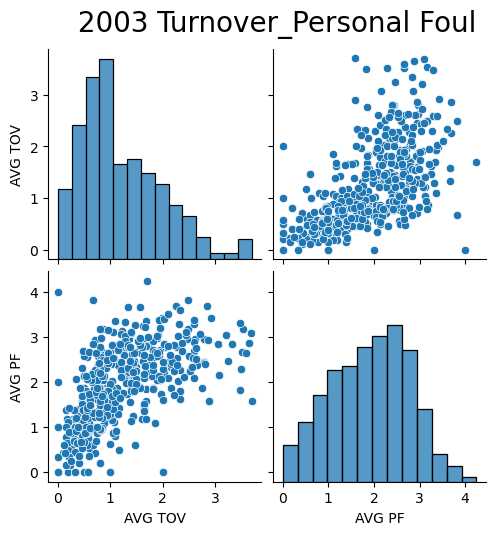

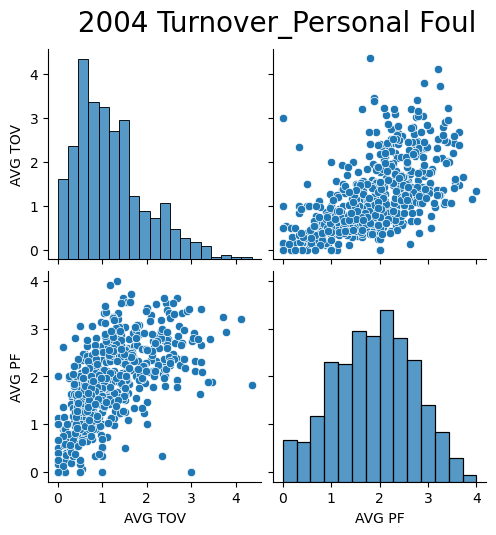

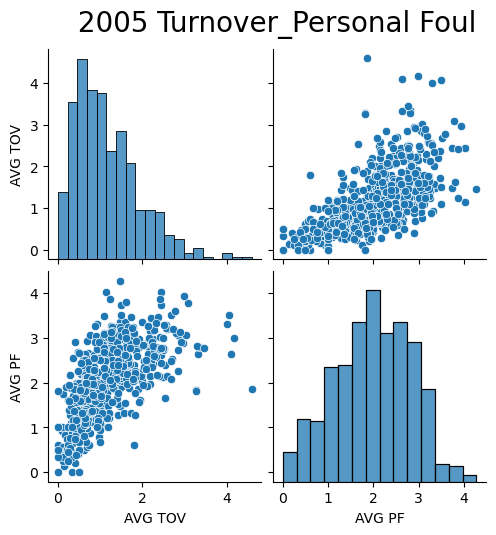

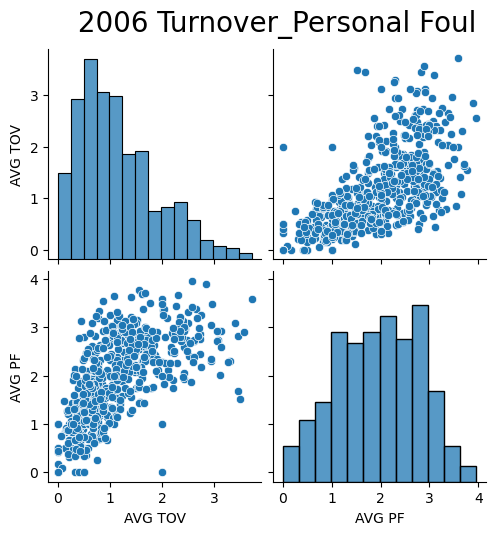

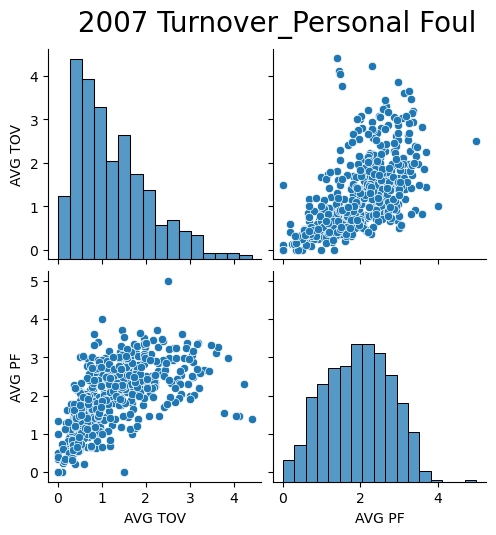

...

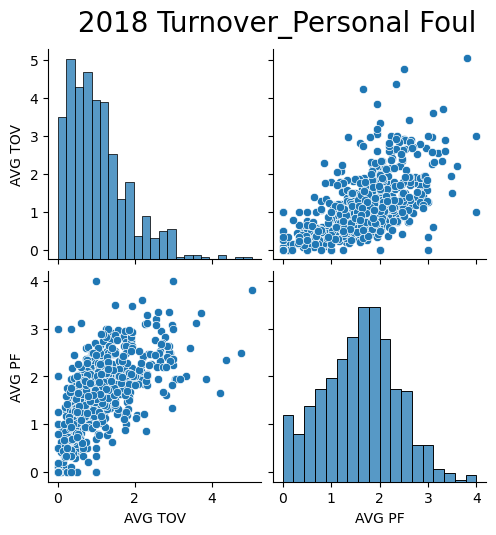

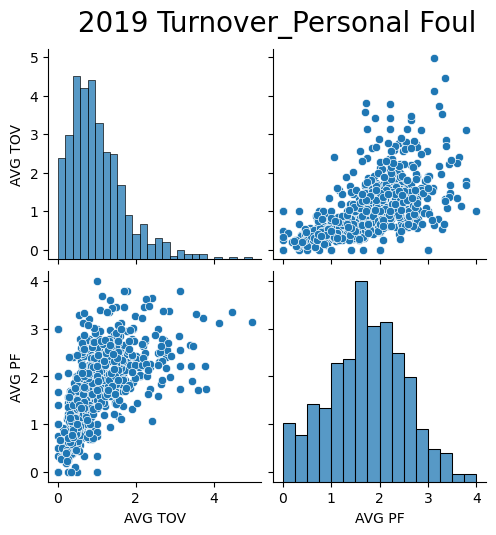

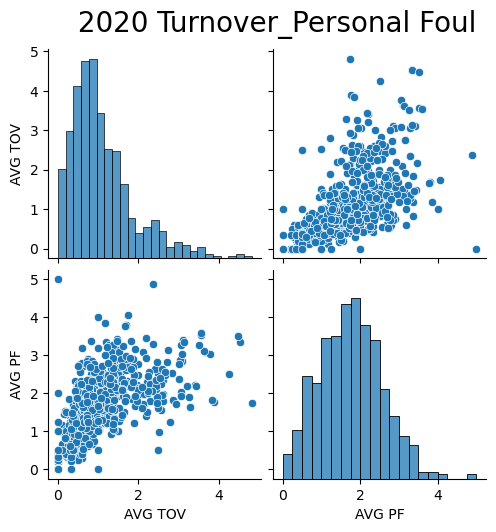

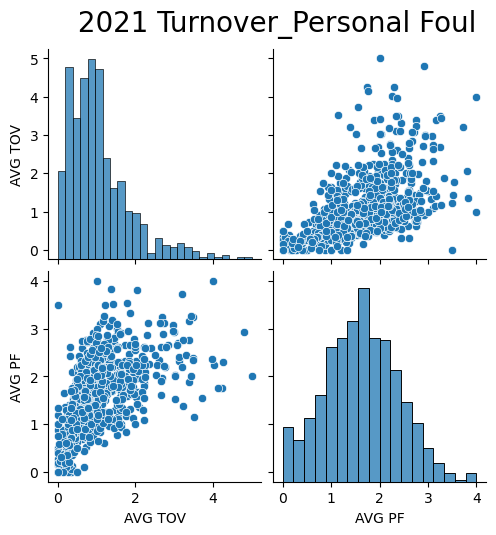

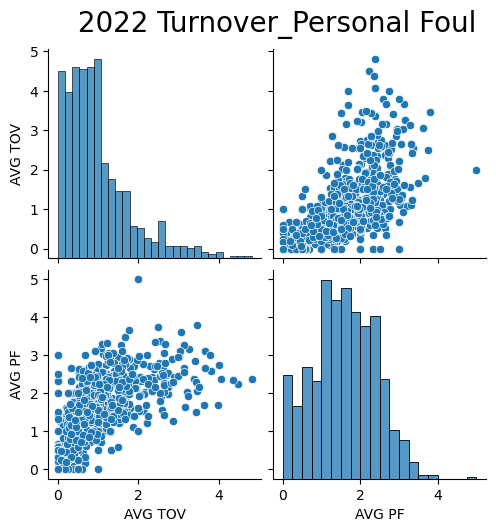

In [25]:
for i in range(1, 21):
    sns.pairplot(dataframes[f"condition_{i}"][["AVG TOV","AVG PF"]])
    plt.title(f" {2002 +i} Turnover_Personal Foul", fontsize=20, y=2.1, x=0)

In [26]:
kmeans_T = {}
for i in range(1, 21):
    kmeans_T[i] = cluster.KMeans(n_clusters=10, init="k-means++")
    kmeans_T[i] = kmeans_R[i].fit(dataframes[f"condition_{i}"][["AVG TOV", "AVG PF"]])
    kmeans_T[i].cluster_centers_
    dataframes[f"condition_{i}"]["Turnover_Personal Foul Clusters"] = kmeans_T[i].labels_
    dataframes[f"condition_{i}"].head()
    print(f"Turnover_Personal Foul Clusters for {2002+i}:")
    print(dataframes[f"condition_{i}"]["Turnover_Personal Foul Clusters"].value_counts())

Turnover_Personal Foul Clusters for 2003:
3    77
1    76
0    61
6    52
4    51
9    50
2    35
7    34
8    29
5    18
Name: Turnover_Personal Foul Clusters, dtype: int64
Turnover_Personal Foul Clusters for 2004:
0    90
6    85
8    74
2    71
7    60
3    58
1    47
5    44
4    34
9    22
Name: Turnover_Personal Foul Clusters, dtype: int64
Turnover_Personal Foul Clusters for 2005:
1    99
3    93
9    68
6    66
7    65
5    58
4    49
8    45
2    33
0     9
Name: Turnover_Personal Foul Clusters, dtype: int64
Turnover_Personal Foul Clusters for 2006:
5    100
1     87
4     74
3     62
7     57
2     47
6     42
0     40
8     36
9     18
Name: Turnover_Personal Foul Clusters, dtype: int64
Turnover_Personal Foul Clusters for 2007:
3    87
2    85
6    68
7    64
1    58
5    57
9    42
4    30
0    20
8     5
Name: Turnover_Personal Foul Clusters, dtype: int64
Turnover_Personal Foul Clusters for 2008:
7    111
0     88
1     81
3     74
6     70
8     50
9     38
2     32
4     

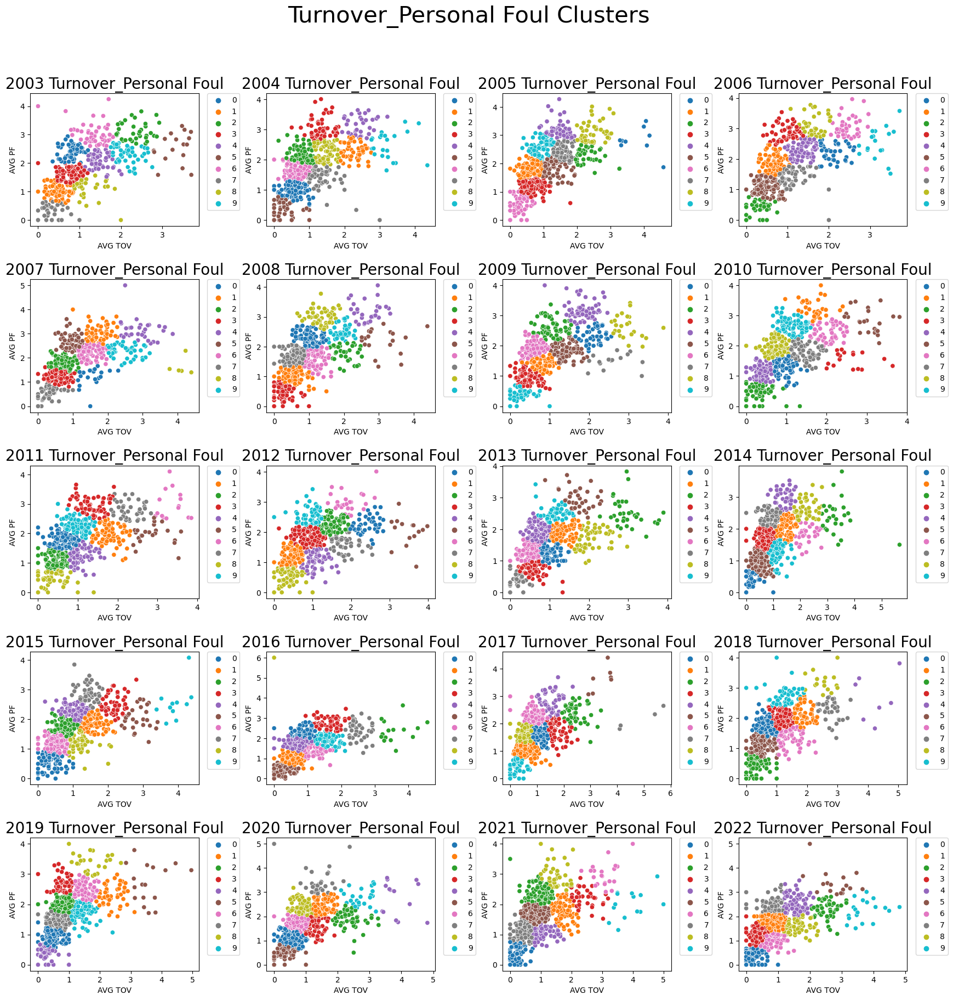

In [27]:
fig, axes = plt.subplots(nrows=5, ncols=4, figsize=(20, 20))
fig.suptitle("Turnover_Personal Foul Clusters", fontsize=30)
plt.subplots_adjust(left=0.1, right=0.9, top=0.9, bottom=0.1, wspace=0.4, hspace=0.4)
for i, ax in enumerate(axes.flatten()):
    sns.scatterplot(x="AVG TOV", y="AVG PF", hue="Turnover_Personal Foul Clusters", data=dataframes[f"condition_{i+1}"], palette="tab10", ax=ax)
    ax.set_title(f"{2003+i} Turnover_Personal Foul", fontsize=20)
    ax.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0., prop={'size': 10})
    ax.set_xlabel("AVG TOV")
    ax.set_ylabel("AVG PF")

<Figure size 2000x2000 with 0 Axes>

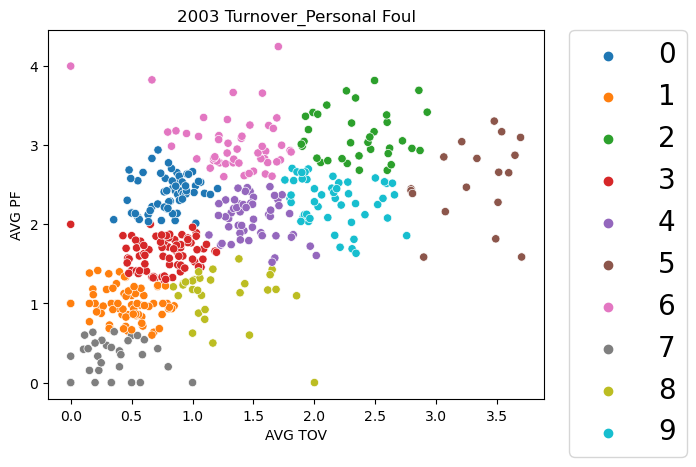

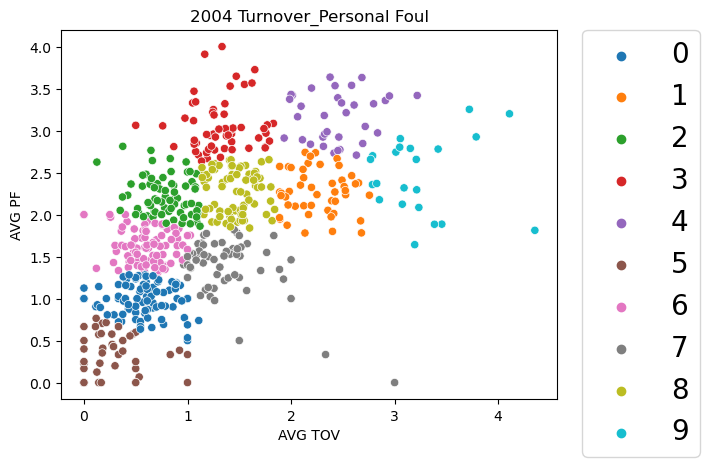

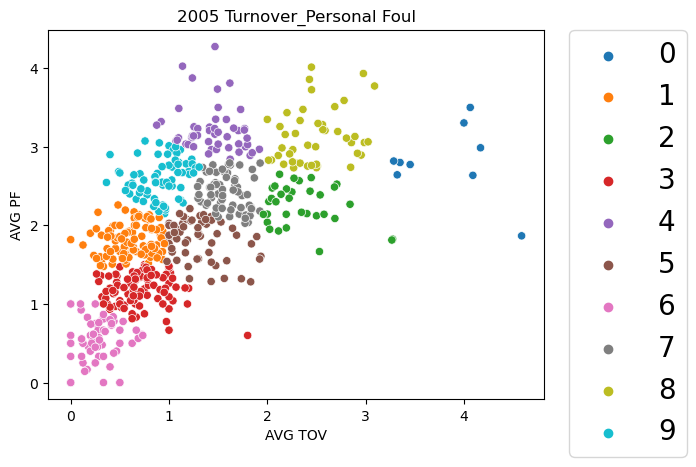

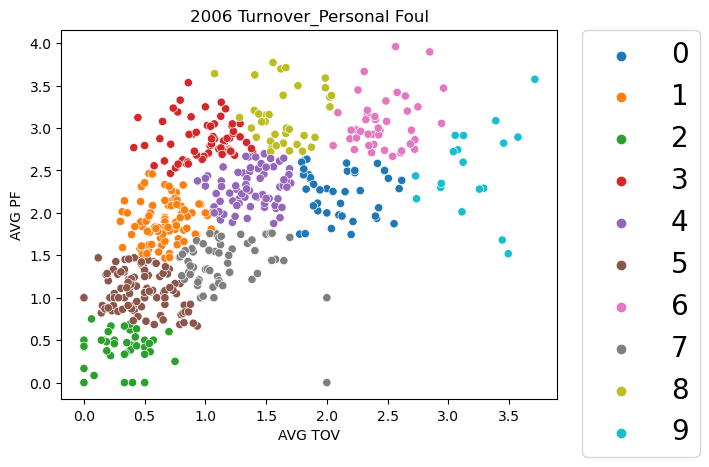

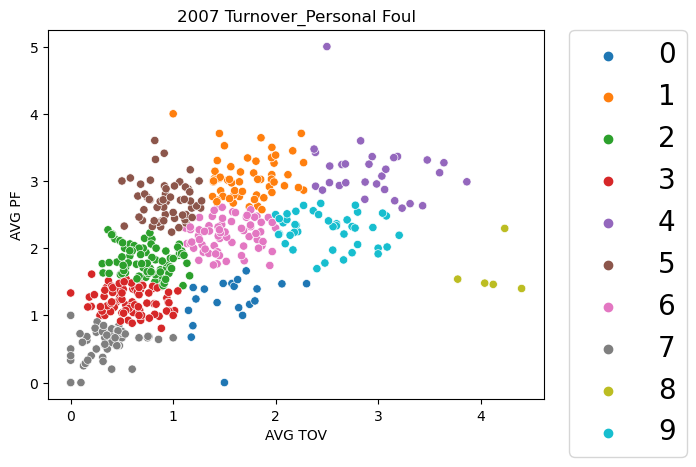

...

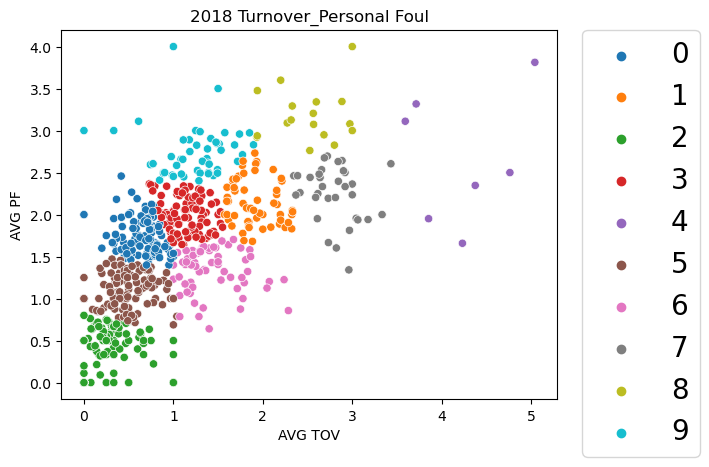

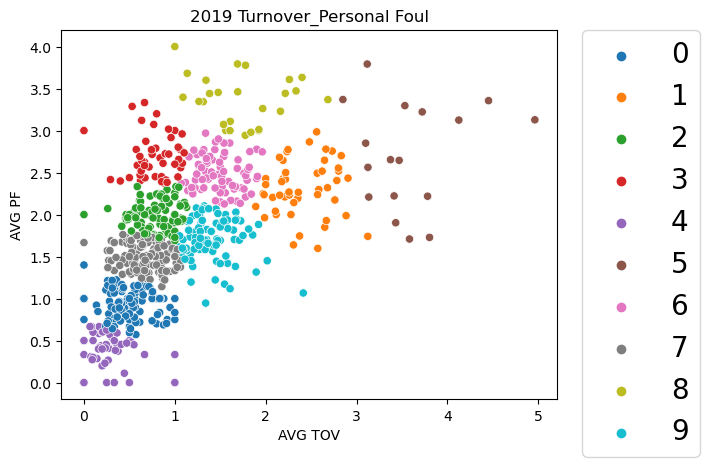

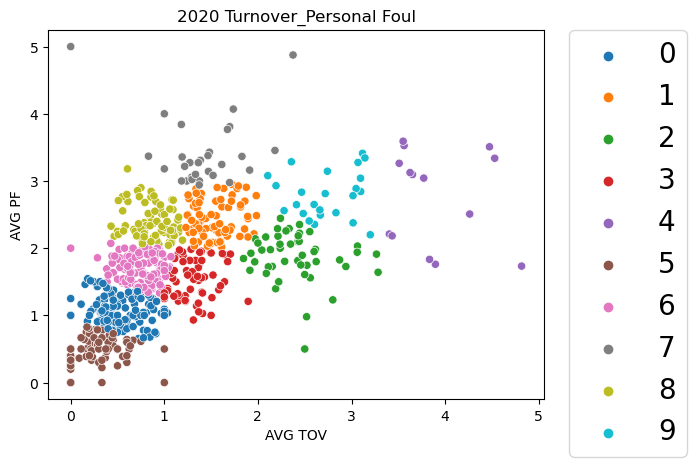

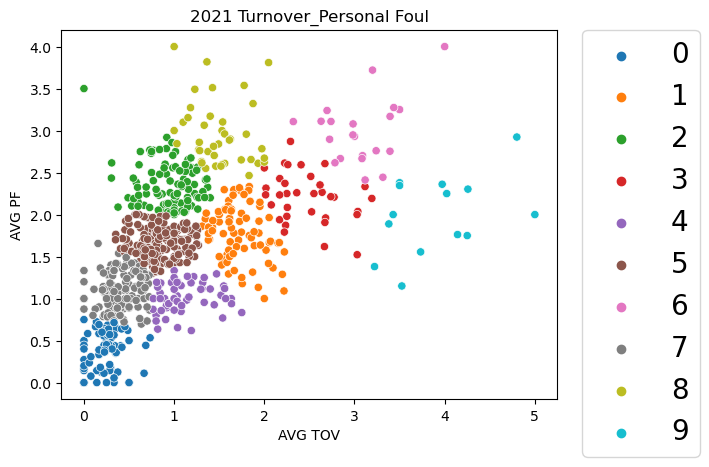

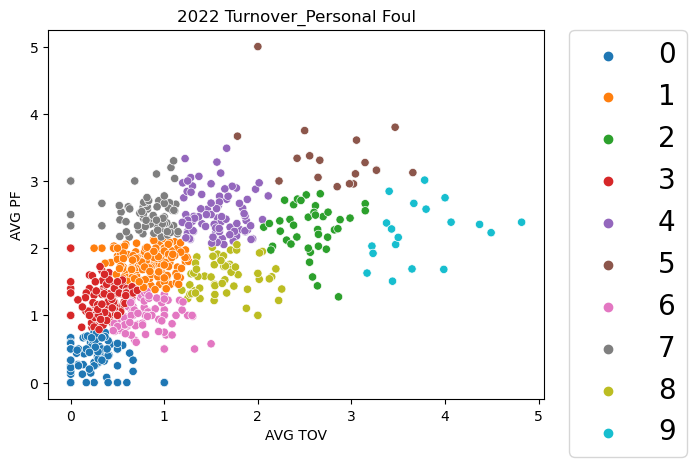

In [28]:
fig = plt.figure(figsize=(20, 20))
for i in range(1, 21):
    plt.figure()
    plt.rcParams['font.size'] = 10
    sns.scatterplot(x="AVG TOV",y="AVG PF",hue = "Turnover_Personal Foul Clusters", data = dataframes[f"condition_{i}"], palette="tab10")
    plt.title(f"{2002 + i} Turnover_Personal Foul")
    plt.legend(bbox_to_anchor=(1.05, 1), loc=2, borderaxespad=0.,prop={'size': 20})

In [29]:
conditions_T = {}
for i in range(1, 21):
    groups = dataframes[f"condition_{i}"].groupby('Turnover_Personal Foul Clusters')
    conditions_T[i] = groups.agg({'AVG TOV': 'max', 'AVG PF': 'max'})
    print(f"{2002+i} - Turnover_Personal Foul Clusters:")
    print(conditions_T[i].round(2))
    print()

2003 - Turnover_Personal Foul Clusters:
                                 AVG TOV  AVG PF
Turnover_Personal Foul Clusters                 
0                                   1.21    2.94
1                                   0.85    1.42
2                                   2.93    3.82
3                                   1.20    2.00
4                                   2.02    2.48
5                                   3.70    3.30
6                                   1.81    4.25
7                                   1.00    0.64
8                                   2.00    1.56
9                                   2.76    2.71

2004 - Turnover_Personal Foul Clusters:
                                 AVG TOV  AVG PF
Turnover_Personal Foul Clusters                 
0                                   1.11    1.28
1                                   2.76    2.74
2                                   1.12    2.81
3                                   1.83    4.00
4                                   3

**Decision Tree**

In [30]:
dataframes_NEW = {}
O_TOP_3 = {}
O_MID_4 = {}
O_BOT_3 = {}

R_TOP_3 = {}
R_MID_4 = {}
R_BOT_3 = {}

D_TOP_3 = {}
D_MID_4 = {}
D_BOT_3 = {}

# T_TOP_3 = {}
# T_MID_4 = {}
# T_BOT_3 = {}

for i in range(1, 21):
    dataframes_NEW[f"condition_{i}"] = dataframes[f"condition_{i}"].drop(dataframes[f"condition_{i}"].columns[[0, 1, 3, 4, 6]], axis=1)
    O_TOP_3[f"Top_3_{2002+i}"] = dataframes[f"condition_{i}"]["Offensive Clusters"].value_counts().head(3).index.tolist()
    O_MID_4[f"MID_4_{2002+i}"] = dataframes[f"condition_{i}"]["Offensive Clusters"].value_counts().iloc[3:7].index.tolist()
    O_BOT_3[f"BOT_3_{2002+i}"] = dataframes[f"condition_{i}"]["Offensive Clusters"].value_counts().tail(3).index.tolist()
    
    R_TOP_3[f"Top_3_{2002+i}"] = dataframes[f"condition_{i}"]["Rebound Clusters"].value_counts().head(3).index.tolist()
    R_MID_4[f"MID_4_{2002+i}"] = dataframes[f"condition_{i}"]["Rebound Clusters"].value_counts().iloc[3:7].index.tolist()
    R_BOT_3[f"BOT_3_{2002+i}"] = dataframes[f"condition_{i}"]["Rebound Clusters"].value_counts().tail(3).index.tolist()
    
    D_TOP_3[f"Top_3_{2002+i}"] = dataframes[f"condition_{i}"]["Offensive Clusters"].value_counts().head(3).index.tolist()
    D_MID_4[f"MID_4_{2002+i}"] = dataframes[f"condition_{i}"]["Offensive Clusters"].value_counts().iloc[3:7].index.tolist()
    D_BOT_3[f"BOT_3_{2002+i}"] = dataframes[f"condition_{i}"]["Offensive Clusters"].value_counts().tail(3).index.tolist()
    
#     T_TOP_3[f"Top_3_{2002+i}"] = dataframes[f"condition_{i}"]["Offensive Clusters"].value_counts().head(3).index.tolist()
#     T_MID_4[f"MID_4_{2002+i}"] = dataframes[f"condition_{i}"]["Offensive Clusters"].value_counts().iloc[3:7].index.tolist()
#     T_BOT_3[f"BOT_3_{2002+i}"] = dataframes[f"condition_{i}"]["Offensive Clusters"].value_counts().tail(3).index.tolist()

**Offensive Player Dicision Tree**

In [31]:
from sklearn import metrics

features = ['AVG PTS', 'AVG AST']
labels = ['Offensive Clusters']
for i in range(1, 21):
    X = dataframes_NEW[f"condition_{i}"][features]
    y = dataframes_NEW[f"condition_{i}"][labels]

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    dt_classifier = DecisionTreeClassifier()

    dt_classifier.fit(X_train, y_train)

    y_pred = dt_classifier.predict(X_test)
    accuracy = metrics.accuracy_score(y_test, y_pred)
    print(f"{2002+i} Offensive Player Dicision Tree Accuracy:", accuracy.round(3))

class_names = [str(c) for c in dt_classifier.classes_]
plt.figure(figsize=(40, 20), dpi=1000)
plot_tree(dt_classifier, feature_names=features, class_names=class_names, filled=True)
plt.show()

2003 Offensive Player Dicision Tree Accuracy: 0.99
2004 Offensive Player Dicision Tree Accuracy: 0.974
2005 Offensive Player Dicision Tree Accuracy: 0.974
2006 Offensive Player Dicision Tree Accuracy: 0.92
2007 Offensive Player Dicision Tree Accuracy: 0.971
2008 Offensive Player Dicision Tree Accuracy: 0.924
2009 Offensive Player Dicision Tree Accuracy: 0.983
2010 Offensive Player Dicision Tree Accuracy: 0.983
2011 Offensive Player Dicision Tree Accuracy: 0.96
2012 Offensive Player Dicision Tree Accuracy: 0.937
2013 Offensive Player Dicision Tree Accuracy: 0.974
2014 Offensive Player Dicision Tree Accuracy: 0.951
2015 Offensive Player Dicision Tree Accuracy: 0.947
2016 Offensive Player Dicision Tree Accuracy: 0.948
2017 Offensive Player Dicision Tree Accuracy: 0.958
2018 Offensive Player Dicision Tree Accuracy: 0.962
2019 Offensive Player Dicision Tree Accuracy: 0.93
2020 Offensive Player Dicision Tree Accuracy: 0.969
2021 Offensive Player Dicision Tree Accuracy: 0.957
2022 Offensive P

**Player Rebound Dicision Tree**

In [32]:
features = ['AVG ORB', 'AVG TRB']
labels = ['Rebound Clusters']
for i in range(1, 21):
    X = dataframes_NEW[f"condition_{i}"][features]
    y = dataframes_NEW[f"condition_{i}"][labels]

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    dt_classifier = DecisionTreeClassifier()

    dt_classifier.fit(X_train, y_train)

    y_pred = dt_classifier.predict(X_test)
    accuracy = metrics.accuracy_score(y_test, y_pred)
    print(f"{2002+i} Player Rebound Dicision Tree Accuracy:", accuracy.round(3))

class_names = [str(c) for c in dt_classifier.classes_]
plt.figure(figsize=(40, 20), dpi=1000)
plot_tree(dt_classifier, feature_names=features, class_names=class_names, filled=True)
plt.show()

2003 Player Rebound Dicision Tree Accuracy: 0.959
2004 Player Rebound Dicision Tree Accuracy: 0.932
2005 Player Rebound Dicision Tree Accuracy: 0.932
2006 Player Rebound Dicision Tree Accuracy: 0.92
2007 Player Rebound Dicision Tree Accuracy: 0.942
2008 Player Rebound Dicision Tree Accuracy: 0.958
2009 Player Rebound Dicision Tree Accuracy: 0.949
2010 Player Rebound Dicision Tree Accuracy: 0.94
2011 Player Rebound Dicision Tree Accuracy: 0.912
2012 Player Rebound Dicision Tree Accuracy: 0.901
2013 Player Rebound Dicision Tree Accuracy: 0.948
2014 Player Rebound Dicision Tree Accuracy: 0.902
2015 Player Rebound Dicision Tree Accuracy: 0.931
2016 Player Rebound Dicision Tree Accuracy: 0.94
2017 Player Rebound Dicision Tree Accuracy: 0.899
2018 Player Rebound Dicision Tree Accuracy: 0.947
2019 Player Rebound Dicision Tree Accuracy: 0.915
2020 Player Rebound Dicision Tree Accuracy: 0.947
2021 Player Rebound Dicision Tree Accuracy: 0.929
2022 Player Rebound Dicision Tree Accuracy: 0.933


**Defensive Player Dicision Tree**

In [33]:
features = ['AVG STL', 'AVG BLK']
labels = ['Defensive Clusters']
for i in range(1, 21):
    X = dataframes_NEW[f"condition_{i}"][features]
    y = dataframes_NEW[f"condition_{i}"][labels]

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    dt_classifier = DecisionTreeClassifier()

    dt_classifier.fit(X_train, y_train)

    y_pred = dt_classifier.predict(X_test)
    accuracy = metrics.accuracy_score(y_test, y_pred)
    print(f"{2002+i} Defensive Player Dicision Tree Accuracy:", accuracy.round(3))

class_names = [str(c) for c in dt_classifier.classes_]
plt.figure(figsize=(40, 20), dpi=1000)
plot_tree(dt_classifier, feature_names=features, class_names=class_names, filled=True)
plt.show()

2003 Defensive Player Dicision Tree Accuracy: 0.959
2004 Defensive Player Dicision Tree Accuracy: 0.957
2005 Defensive Player Dicision Tree Accuracy: 0.966
2006 Defensive Player Dicision Tree Accuracy: 0.973
2007 Defensive Player Dicision Tree Accuracy: 0.904
2008 Defensive Player Dicision Tree Accuracy: 0.941
2009 Defensive Player Dicision Tree Accuracy: 0.966
2010 Defensive Player Dicision Tree Accuracy: 0.931
2011 Defensive Player Dicision Tree Accuracy: 0.96
2012 Defensive Player Dicision Tree Accuracy: 0.955
2013 Defensive Player Dicision Tree Accuracy: 0.939
2014 Defensive Player Dicision Tree Accuracy: 0.911
2015 Defensive Player Dicision Tree Accuracy: 0.977
2016 Defensive Player Dicision Tree Accuracy: 0.922
2017 Defensive Player Dicision Tree Accuracy: 0.966
2018 Defensive Player Dicision Tree Accuracy: 0.955
2019 Defensive Player Dicision Tree Accuracy: 0.951
2020 Defensive Player Dicision Tree Accuracy: 0.947
2021 Defensive Player Dicision Tree Accuracy: 0.943
2022 Defensiv

**Turnover_Personal Foul Dicision Tree**

In [34]:
features = ['AVG TOV', 'AVG PF']
labels = ['Turnover_Personal Foul Clusters']
for i in range(1, 21):
    X = dataframes_NEW[f"condition_{i}"][features]
    y = dataframes_NEW[f"condition_{i}"][labels]

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

    dt_classifier = DecisionTreeClassifier()

    dt_classifier.fit(X_train, y_train)

    y_pred = dt_classifier.predict(X_test)
    accuracy = metrics.accuracy_score(y_test, y_pred)
    print(f"{2002+i} Player Turnover_Personal Foul Dicision Tree Accuracy:", accuracy.round(3))

class_names = [str(c) for c in dt_classifier.classes_]
plt.figure(figsize=(40, 20), dpi=1000)
plot_tree(dt_classifier, feature_names=features, class_names=class_names, filled=True)
plt.show()

2003 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.887
2004 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.94
2005 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.915
2006 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.903
2007 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.942
2008 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.958
2009 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.915
2010 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.922
2011 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.936
2012 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.919
2013 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.896
2014 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.943
2015 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.893
2016 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.922
2017 Player Turnover_Personal Foul Dicision Tree Accuracy: 0.966
2018 Player Turnover_Perso

**Salary**

In [35]:
for i in range(1, 21):
    Salary = S_dataframes[f"condition_{i}"]["Salary"].str.replace(',', '').str.replace('$', '').astype(int)
    Inf_Salary = S_dataframes[f"condition_{i}"]["inflationAdjSalary"].str.replace(',', '').str.replace('$', '').astype(int)
    S_dataframes[f"condition_{i}"]["Salary"] = Salary
    S_dataframes[f"condition_{i}"]["inflationAdjSalary"] = Inf_Salary
    
    PayRoll = P_dataframes[f"condition_{i}"]["PayRoll"].str.replace(',', '').str.replace('$', '').astype(int)
    Inf_PayRoll  = P_dataframes[f"condition_{i}"]["inflationAdjPayroll"].str.replace(',', '').str.replace('$', '').astype(int)
    P_dataframes[f"condition_{i}"]["PayRoll"] = PayRoll 
    P_dataframes[f"condition_{i}"]["inflationAdjPayroll"] = Inf_PayRoll 
    

In [36]:
merged_df ={}
for i in range(1, 21):
    merged_df[f"condition_{i}"] = pd.merge(dataframes[f"condition_{i}"][["Player", "Season", "Offensive Clusters", "Rebound Clusters", "Defensive Clusters"]], S_dataframes[f"condition_{i}"][["Player", "Salary"]], left_on='Player', right_on='Player', how='left')
    merged_df[f"condition_{i}"]["Salary"] = merged_df[f"condition_{i}"]["Salary"].fillna(merged_df[f"condition_{i}"]["Salary"])
    merged_df[f"condition_{i}"] = merged_df[f"condition_{i}"].rename(columns={"Salary": "Salary"})
    merged_df[f"condition_{i}"].dropna(inplace=True)
    

In [37]:


merged_df_New = merged_df.copy()

for i in range(1, 21):
    O_values = ["TOP3", "MID4", "BOT3"]
    R_values = ["TOP3", "MID4", "BOT3"]
    D_values = ["TOP3", "MID4", "BOT3"]
    O_conditions = [O_TOP_3[f"Top_3_{2002+i}"], O_MID_4[f"MID_4_{2002+i}"], O_BOT_3[f"BOT_3_{2002+i}"]]
    R_conditions = [R_TOP_3[f"Top_3_{2002+i}"], R_MID_4[f"MID_4_{2002+i}"], R_BOT_3[f"BOT_3_{2002+i}"]]
    D_conditions = [D_TOP_3[f"Top_3_{2002+i}"], D_MID_4[f"MID_4_{2002+i}"], D_BOT_3[f"BOT_3_{2002+i}"]]
    
    for condition, value in zip(O_conditions, O_values):
        mask = merged_df_New[f"condition_{i}"]['Offensive Clusters'].isin(condition)
        merged_df_New[f"condition_{i}"].loc[mask, 'Offensive Clusters'] = value
        
    for condition, value in zip(R_conditions, R_values):
        mask = merged_df_New[f"condition_{i}"]['Rebound Clusters'].isin(condition)
        merged_df_New[f"condition_{i}"].loc[mask, 'Rebound Clusters'] = value
        
    for condition, value in zip(D_conditions, D_values):
        mask = merged_df_New[f"condition_{i}"]['Defensive Clusters'].isin(condition)
        merged_df_New[f"condition_{i}"].loc[mask, 'Defensive Clusters'] = value    

In [38]:
for i in range(1, 21):
    
    q75 = merged_df_New[f"condition_{i}"]["Salary"].quantile(0.75)
    q25 = merged_df_New[f"condition_{i}"]["Salary"].quantile(0.25)
    
    merged_df_New[f"condition_{i}"]['Salary group'] = "MID4"
    for index, row in merged_df_New[f"condition_{i}"].iterrows():
        if row['Salary'] > q75:
            merged_df_New[f"condition_{i}"].loc[index, 'Salary group'] = "TOP3"
        elif row['Salary'] < q25:
            merged_df_New[f"condition_{i}"].loc[index, 'Salary group'] = "BOT3"
    

In [39]:
from sklearn.preprocessing import LabelEncoder
from sklearn.tree import DecisionTreeClassifier, export_text
import matplotlib.pyplot as plt
from sklearn.tree import plot_tree

np.random.seed(12345)
train_idx = np.random.choice(merged_df_New["condition_19"].index, size=int(0.8*len(merged_df_New["condition_19"])), replace=False)
test_idx = np.setdiff1d(merged_df_New["condition_19"].index, train_idx)

NBA_train = merged_df_New["condition_19"].loc[train_idx, :]

NBA_test = merged_df_New["condition_19"].loc[test_idx, :]

penalty_matrix = np.array([[0, 1], [10, 0]])

le = LabelEncoder()
NBA_train["Salary group"] = le.fit_transform(NBA_train["Salary group"])

for col in NBA_train.columns:
    if NBA_train[col].dtype == "object":
        NBA_train[col] = le.fit_transform(NBA_train[col])

tree = DecisionTreeClassifier(criterion="entropy", random_state=12345, class_weight={0: 1, 1: 10})
tree.fit(NBA_train.iloc[:, 1:], NBA_train["Salary group"])
tree_text = export_text(tree)

plt.figure(figsize=(40,20), dpi=500)
plot_tree(tree, feature_names=NBA_train.columns[1:], filled=True, 
          class_names=["TOP3", "MID4", "BOT3"], impurity=True)
plt.show()

In [40]:
merged_df_Stat ={}
for i in range(1, 21):
    merged_df_Stat[f"condition_{i}"] = pd.merge(dataframes[f"condition_{i}"][["Player", "Season", "AVG MP","AVG ORB","AVG DRB","AVG TRB","AVG AST","AVG STL","AVG BLK","AVG TOV","AVG PF", "AVG PTS",]], S_dataframes[f"condition_{i}"][["Player", "Salary"]], left_on='Player', right_on='Player', how='left')
    merged_df_Stat[f"condition_{i}"]["Salary"] = merged_df_Stat[f"condition_{i}"]["Salary"].fillna(merged_df_Stat[f"condition_{i}"]["Salary"])
    merged_df_Stat[f"condition_{i}"] = merged_df_Stat[f"condition_{i}"].rename(columns={"Salary": "Salary"})
    merged_df_Stat[f"condition_{i}"].dropna(inplace=True)

In [41]:
for i in range(1, 21):
    
    q75 = merged_df_Stat[f"condition_{i}"]["Salary"].quantile(0.75)
    q25 = merged_df_Stat[f"condition_{i}"]["Salary"].quantile(0.25)
    
    merged_df_Stat[f"condition_{i}"]['Salary group'] = "MID4"
    for index, row in merged_df_Stat[f"condition_{i}"].iterrows():
        if row['Salary'] > q75:
            merged_df_Stat[f"condition_{i}"].loc[index, 'Salary group'] = "TOP3"
        elif row['Salary'] < q25:
            merged_df_Stat[f"condition_{i}"].loc[index, 'Salary group'] = "BOT3"

In [43]:
for i in range(1, 21): 
    merged_df_New[f"condition_{i}"]['Salary Worth'] = "Okay"
    merged_df_New[f"condition_{i}"]['Worth Value'] = 0
    for index, row in merged_df_New[f"condition_{i}"].iterrows():
        if row['Offensive Clusters'] == "TOP3":
            merged_df_New[f"condition_{i}"].loc[index, 'Worth Value'] += 1
        elif row['Offensive Clusters'] == "BOT3":
            merged_df_New[f"condition_{i}"].loc[index, 'Worth Value'] -= 1
        else:
            merged_df_New[f"condition_{i}"].loc[index, 'Worth Value'] += 0
        
        if row['Rebound Clusters'] == "TOP3":
            merged_df_New[f"condition_{i}"].loc[index, 'Worth Value'] += 1
        elif row['Rebound Clusters'] == "BOT3":
            merged_df_New[f"condition_{i}"].loc[index, 'Worth Value'] -= 1
        else:
            merged_df_New[f"condition_{i}"].loc[index, 'Worth Value'] += 0
        
        if row['Defensive Clusters'] == "TOP3":
            merged_df_New[f"condition_{i}"].loc[index, 'Worth Value'] += 1
        elif row['Defensive Clusters'] == "BOT3":
            merged_df_New[f"condition_{i}"].loc[index, 'Worth Value'] -= 1
        else:
            merged_df_New[f"condition_{i}"].loc[index, 'Worth Value'] += 0
    for index, row in merged_df_New[f"condition_{i}"].iterrows():
        
        if row['Salary group'] == "TOP3":
            merged_df_New[f"condition_{i}"].loc[index, 'Worth Value'] -= 1
        elif row['Salary group'] == "BOT3":
            merged_df_New[f"condition_{i}"].loc[index, 'Worth Value'] += 1
            
    for index, row in merged_df_New[f"condition_{i}"].iterrows():
        if row['Worth Value'] >= 2 :
            merged_df_New[f"condition_{i}"].loc[index, 'Salary Worth'] = "Worth it"
        elif row['Worth Value'] <= -2:
            merged_df_New[f"condition_{i}"].loc[index, 'Salary Worth'] = "Not Worth it"
                  
CCC=merged_df_New["condition_19"].drop_duplicates(subset=['Player'])
CCC.iloc[100:110].round(2)

,Player,Season,Offensive Clusters,Rebound Clusters,Defensive Clusters,Salary,Salary group,Salary Worth,Worth Value
303,Donte DiVincenzo,2021,MID4,MID4,BOT3,4675830.0,MID4,Okay,-1
306,Luguentz Dort,2021,MID4,TOP3,MID4,1782621.0,MID4,Okay,1
308,Damyean Dotson,2021,TOP3,TOP3,BOT3,205662.0,BOT3,Worth it,2
310,Devon Dotson,2021,TOP3,MID4,BOT3,239291.0,BOT3,Okay,1
312,Sekou Doumbouya,2021,TOP3,TOP3,BOT3,3799131.0,MID4,Okay,1
314,PJ Dozier,2021,TOP3,TOP3,TOP3,1910860.0,MID4,Worth it,3
317,Andre Drummond,2021,MID4,BOT3,BOT3,2401537.0,MID4,Not Worth it,-2
324,Kris Dunn,2021,TOP3,TOP3,TOP3,5317430.0,MID4,Worth it,3
326,Kevin Durant,2021,BOT3,BOT3,MID4,42018900.0,TOP3,Not Worth it,-3
327,Anthony Edwards,2021,MID4,MID4,BOT3,10245480.0,TOP3,Not Worth it,-2
